In [1]:
import requests
from pathlib import Path
import matplotlib.pyplot as plt
from PIL import Image
import uuid
import hashlib

In [2]:
def get_hash_from_uuid(hash_val: str | None = None, hash_len: int = 5) -> str:
    # Generate a UUID4 and convert it to a string
    if not hash_val:
        hash_val = str(uuid.uuid4())

    # Hash the UUID string using SHA-256
    hash_object = hashlib.sha256(hash_val.encode())
    hex_dig = hash_object.hexdigest()
    return hex_dig[:hash_len]

In [3]:
FLUX_SERVER_ENDPOINT = 'http://192.165.134.27:22186/flux-generate-image'
FLUX_SERVER_ENDPOINT = 'http://127.0.0.1:11234/flux-generate-image'
FLUX_TIMEOUT = 300
save_dir = 'data_prize_words/generated'

In [4]:
Path(save_dir).exists()

True

In [5]:
Path(save_dir).mkdir(parents=True, exist_ok=True)

In [6]:
def flux_get_image_from_prompt(
    prompt: str,
    save_path: str,
    resolution: tuple | None = None,
    num_inference_steps: int = 28,
    guidance_scale: float = 3.5,
    seed: int = 24,
) -> str:
    resolution = resolution if resolution else (1024, 1024)
    width, height = resolution
    data = {
        'prompt': prompt,
        'width': width,
        'height': height,
        'seed': seed,
        'num_inference_steps': num_inference_steps,
        'guidance_scale': guidance_scale,
    }

    response = requests.post(
        FLUX_SERVER_ENDPOINT,
        data=data,
        timeout=FLUX_TIMEOUT,
    )

    if response.status_code == 200:
        with Path(save_path).open('wb') as output_file:
            output_file.write(response.content)

        return save_path
    raise ValueError(f'Bad response from FLUX API. Status code: {response.status_code}')

In [7]:
gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (1024, 1024)
}

In [8]:

# Generate images
def generate_multiple_images(prompt, gen_params):
    words = ['MINI', 'MAJOR', 'MINOR',]
    generated_images = []
    
    for word in words:
        unique_save_path = Path(save_dir) / f"{word}_{get_hash_from_uuid(hash_val=prompt)}.png"
        generated_image = flux_get_image_from_prompt(prompt.format(word=word), save_path=unique_save_path, **gen_params)
        generated_images.append(generated_image)
    return generated_images


def generate_single_image(prompt, word, gen_params):
    unique_save_path = Path(save_dir) / f"{word}_{get_hash_from_uuid(hash_val=prompt)}.png"
    generated_image = flux_get_image_from_prompt(prompt=prompt, save_path=unique_save_path, **gen_params)
    return generated_image


def plot_images(images_paths):
    
    # Plot images in grid
    fig, axes = plt.subplots(1, len(images_paths), figsize=(15, 5))
    for ax, img_path in zip(axes, images_paths):
        image = plt.imread(img_path)
        ax.imshow(image)
        ax.set_title(f"Letter")
        ax.axis("off")
    
    plt.tight_layout()
    plt.show()

In [9]:
gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (1024, 1024)
}

In [10]:
# # Example usage for a single image
single_prompt = """
"The stylized words 'MAJOR,' 'MINI,' 'MINOR,' and 'PRICE' are made in the same **cyberpunk aesthetic**, 
using a glowing neon texture with a high-tech, futuristic look. Each word should be large, bold, and uniform in size, 
designed with sleek, angular edges and subtle **digital glitch effects** to enhance the cyberpunk feel. 
The letters should have a smooth, illuminated appearance with a metallic sheen, featuring **electric blue** as the primary color, 
complemented by **neon magenta and cyan highlights**. A subtle glow surrounds each word, giving a **holographic, digital display** effect.

The words must be arranged in a **perfect 2x2 grid**, evenly spaced and aligned without rotation:
- 'MAJOR' is in the **upper-left corner**.
- 'MINI' is in the **upper-right corner**.
- 'MINOR' is in the **lower-left corner**.
- 'PRICE' is in the **lower-right corner**.

To prevent excessive shrinking, the words should be **positioned slightly lower**, leaving more negative space at the top 
while still maintaining balance in the composition. The font weight and letter spacing should ensure **readability and a strong, futuristic presence**.

The background is completely **pure white**, with no shadows, gradients, or textures, ensuring the words are perfectly isolated 
and contrast against the background. The entire composition is clean, high-tech, and visually engaging."
"""
single_image_path = generate_single_image(prompt=single_prompt, word='PRICE', gen_params=gen_params)

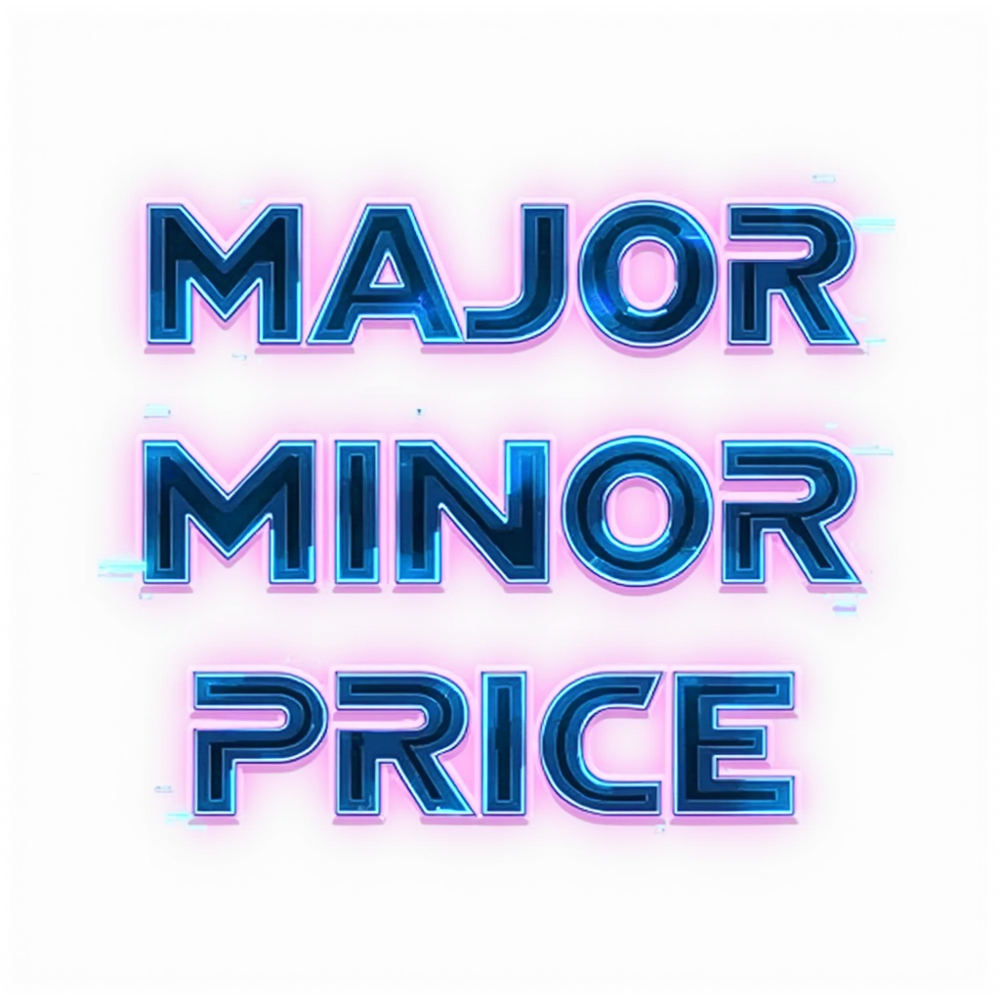

In [11]:
Image.open(single_image_path)

In [16]:
# # Example usage for a single image
single_prompt = """
The stylized words 'MAJOR,' 'MINI,' 'MINOR,' and 'PRICE' are made in the same Shrek-inspired style, using a smooth, organic, fairy-tale texture. Each word should be large, bold, and uniform in size, resembling the whimsical and playful aesthetic of the Shrek universe. The letters should have an earthy green tone with soft, rounded edges and a slightly textured surface, reminiscent of ogre skin. Subtle highlights and a faint glow add a magical, storybook-like charm.

The words must be arranged in a **perfect 2x2 grid**, evenly spaced and aligned without rotation:
- 'MAJOR' is in the **upper-left corner**.
- 'MINI' is in the **upper-right corner**.
- 'MINOR' is in the **lower-left corner**.
- 'PRICE' is in the **lower-right corner**.

The background is completely **pure white**, with no shadows, textures, or gradients, ensuring full isolation of the words. All words are the same size and have a **consistent** Shrek-themed aesthetic, without variation in proportions or angles. The composition is balanced, ensuring readability and clarity.
"""
single_image_path = generate_single_image(prompt=single_prompt, word='PRICE', gen_params=gen_params)

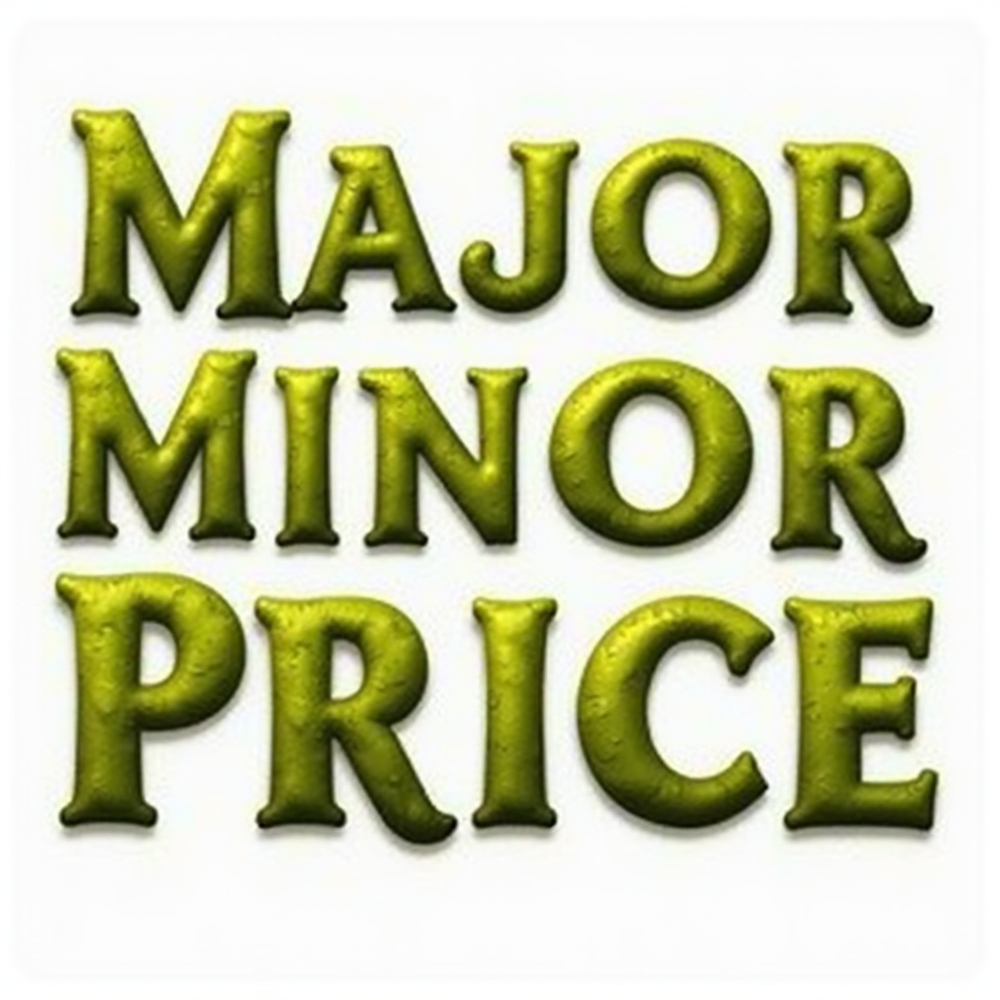

In [17]:
Image.open(single_image_path)

In [18]:
# # Example usage for a single image
single_prompt = """
"The stylized words 'MAJOR,' 'MINI,' 'MINOR,' and 'PRICE' are made in the same **Harry Potter-inspired aesthetic**, using an enchanted, mystical, and magical theme. Each word should be large, bold, and uniform in size, featuring elegant **gothic-style lettering** with a wizardly, medieval touch. The letters should have subtle **golden or silver metallic accents**, resembling the ancient enchanted inscriptions found in Hogwarts. A slight **magical glow or aura** surrounds the letters, enhancing the mystical feel.

The words must be arranged in a **perfect 2x2 grid**, evenly spaced and aligned without rotation:
- 'MAJOR' is in the **upper-left corner**.
- 'MINI' is in the **upper-right corner**.
- 'MINOR' is in the **lower-left corner**.
- 'PRICE' is in the **lower-right corner**.

To ensure the words remain **large and clearly readable**, they should be **positioned slightly lower**, leaving more negative space at the top while still maintaining a balanced and symmetrical layout. The font should reflect **classic wizardry and the magic of the Harry Potter universe**, incorporating elements such as **lightning bolt-inspired strokes, spell-like swirls, or runic embellishments**.

The background is completely **pure white**, with no shadows, gradients, or textures, ensuring the words are perfectly isolated and stand out with a magical aura. The composition should be balanced, enchanting, and visually engaging, evoking the wonder of the Wizarding World."
"""

single_image_path = generate_single_image(prompt=single_prompt, word='PRICE', gen_params=gen_params)

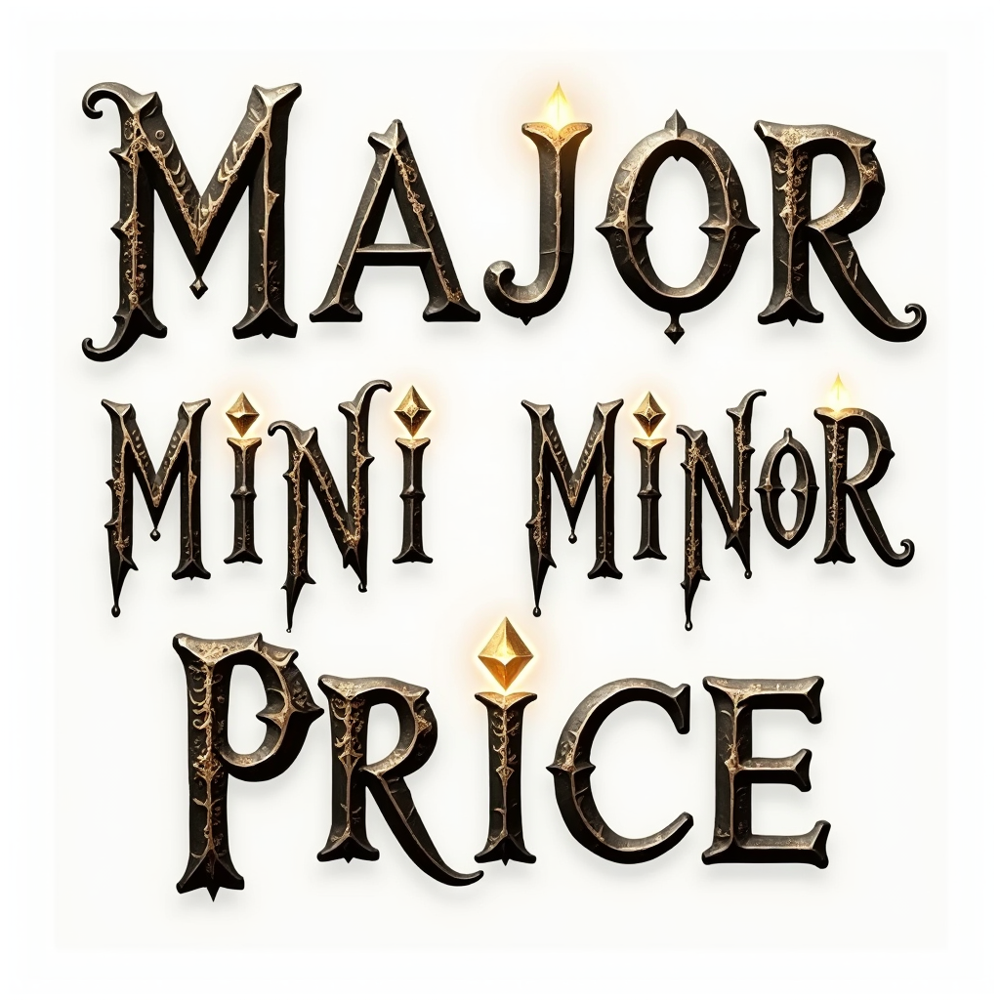

In [19]:
Image.open(single_image_path)

In [25]:
gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

In [26]:
# # Example usage for a single image
single_prompt = """
"The stylized words 'MAJOR,' 'MINI,' 'MINOR,' and 'PRICE' are designed in a **Harry Potter-inspired aesthetic**, 
using an enchanted, mystical, and magical theme. Each word should be large, bold, and uniform in size, featuring elegant **gothic-style lettering** 
with a wizardly, medieval touch. The letters should have subtle **golden or silver metallic accents**, resembling the ancient enchanted inscriptions found in Hogwarts. 
A slight **magical glow or aura** surrounds the letters, enhancing the mystical feel.

**Precise word placement:**
- 'MAJOR' is positioned **on the left, near the top**.
- 'MINI' is positioned **on the right, near the top**.
- 'MINOR' is positioned **directly below 'MAJOR', on the left**.
- 'PRICE' is positioned **directly below 'MINI', on the right**.

The words must be **evenly spaced and perfectly aligned** in this structured layout, ensuring readability and consistency. 
No words should be rotated, tilted, or skewed—each should remain upright and properly proportioned.

To ensure the words remain **large and clearly readable**, they should be positioned in a **clean, structured formation** with balanced spacing. 
The font should reflect **classic wizardry and the magic of the Harry Potter universe**, incorporating elements such as **lightning bolt-inspired strokes, spell-like swirls, or runic embellishments**.

The background is completely **pure white**, with no shadows, gradients, or textures, ensuring the words are **perfectly isolated and sharp**. 
The entire composition should be **balanced, enchanting, and visually engaging**, evoking the wonder of the Wizarding World."
"""

single_image_path = generate_single_image(prompt=single_prompt, word='PRICE', gen_params=gen_params)

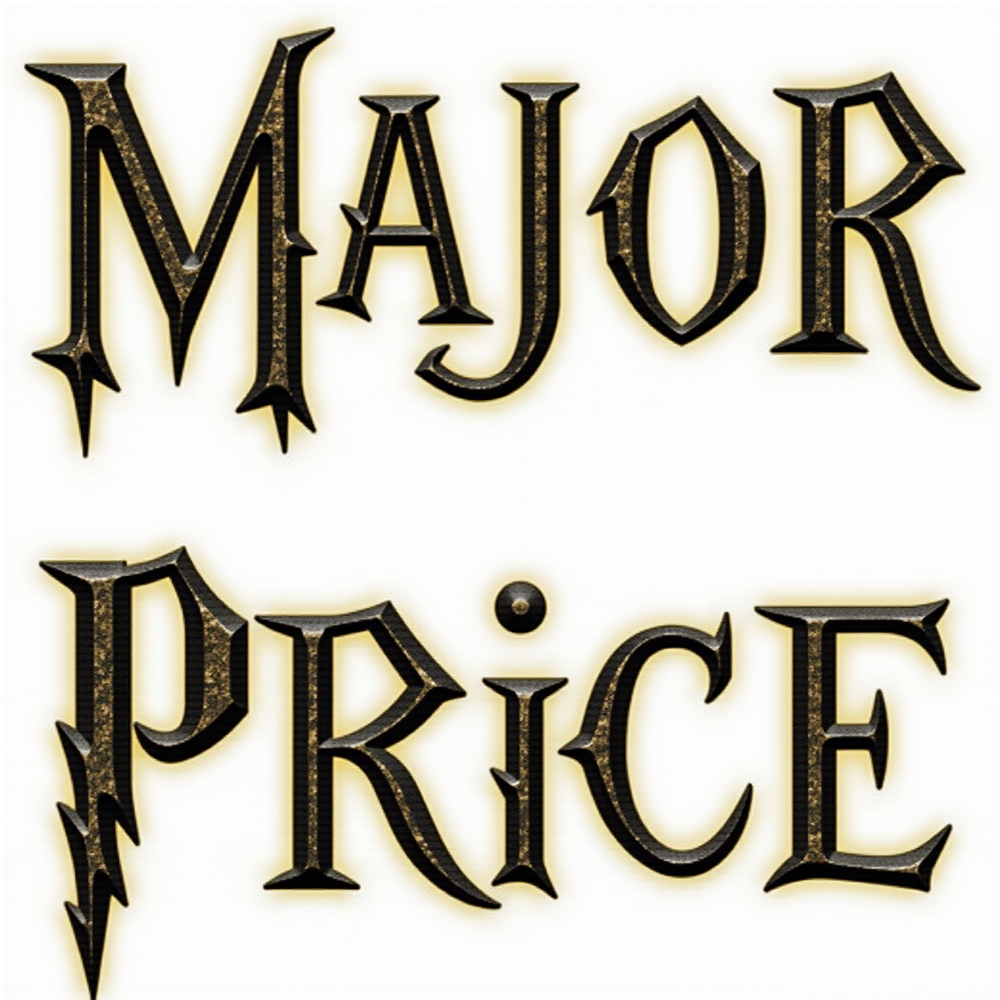

In [27]:
Image.open(single_image_path)

In [28]:
# # Example usage for a single image
single_prompt = """
"The stylized words 'MAJOR,' 'MINI,' 'MINOR,' and 'PRICE' are made in the same **Harry Potter-inspired aesthetic**, using an enchanted, mystical, and magical theme. Each word should be large, bold, and uniform in size, featuring elegant **gothic-style lettering** with a wizardly, medieval touch. The letters should have subtle **golden or silver metallic accents**, resembling the ancient enchanted inscriptions found in Hogwarts. A slight **magical glow or aura** surrounds the letters, enhancing the mystical feel.

The words must be arranged in a **perfect 2x2 grid**, evenly spaced and aligned without rotation:
- 'MAJOR' is in the **upper-left corner**.
- 'MINI' is in the **upper-right corner**.
- 'MINOR' is in the **lower-left corner**.
- 'PRICE' is in the **lower-right corner**.

To ensure the words remain **large and clearly readable**, they should be **positioned slightly lower**, leaving more negative space at the top while still maintaining a balanced and symmetrical layout. The font should reflect **classic wizardry and the magic of the Harry Potter universe**, incorporating elements such as **lightning bolt-inspired strokes, spell-like swirls, or runic embellishments**.

The background is completely **pure white**, with no shadows, gradients, or textures, ensuring the words are perfectly isolated and stand out with a magical aura. The composition should be balanced, enchanting, and visually engaging, evoking the wonder of the Wizarding World."
"""

single_image_path = generate_single_image(prompt=single_prompt, word='PRICE', gen_params=gen_params)

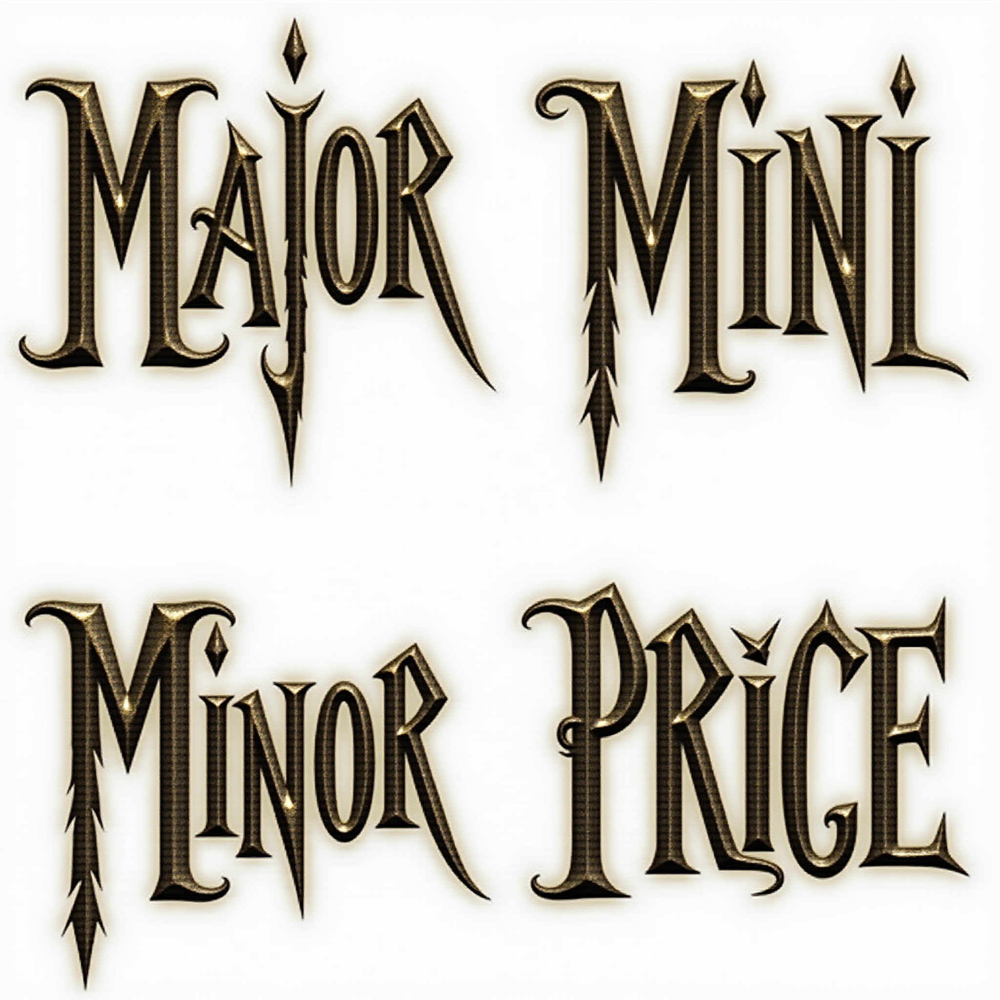

In [29]:
Image.open(single_image_path)

In [31]:
# # Example usage for a single image
single_prompt = """
The stylized words 'MAJOR,' 'MINI,' 'MINOR,' and 'PRICE' are made in the same Shrek-inspired style, using a smooth, organic, fairy-tale texture. Each word should be large, bold, and uniform in size, resembling the whimsical and playful aesthetic of the Shrek universe. The letters should have an earthy green tone with soft, rounded edges and a slightly textured surface, reminiscent of ogre skin. Subtle highlights and a faint glow add a magical, storybook-like charm.

The words must be arranged in a **perfect 2x2 grid**, evenly spaced and aligned without rotation:
- 'MAJOR' is in the **upper-left corner**.
- 'MINI' is in the **upper-right corner**.
- 'MINOR' is in the **lower-left corner**.
- 'PRICE' is in the **lower-right corner**.

The background is completely **pure white**, with no shadows, textures, or gradients, ensuring full isolation of the words. All words are the same size and have a **consistent** Shrek-themed aesthetic, without variation in proportions or angles. The composition is balanced, ensuring readability and clarity.
"""
single_image_path = generate_single_image(prompt=single_prompt, word='PRICE', gen_params=gen_params)

### Splitting into sepearate

In [37]:
im_pth = 'data_prize_words/generated/PRICE_a4b1a.png'

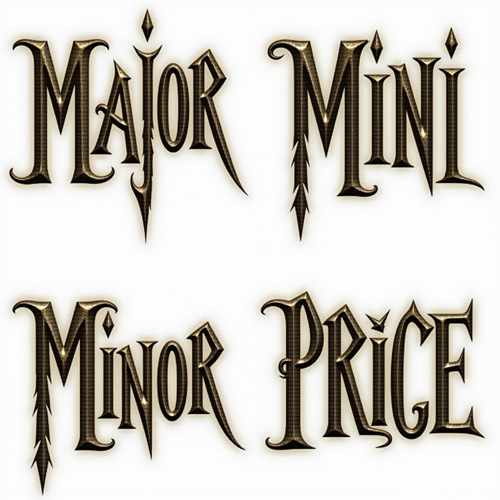

In [39]:
Image.open(im_pth).resize((500, 500))

In [42]:
import cv2

In [ ]:
print('hi')

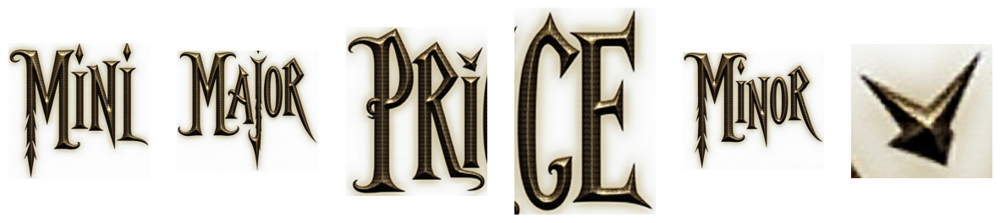

6

In [44]:
# Improve bounding box detection to group letters into full words
import numpy as np

image_path = 'data_prize_words/generated/PRICE_a4b1a.png'  # Replace with your actual image path
image = Image.open(image_path).convert("RGB")  # Open and convert to RGB
image_cv = np.array(image) 

# Convert to grayscale and apply threshold
gray = cv2.cvtColor(image_cv, cv2.COLOR_RGB2GRAY)
_, thresh = cv2.threshold(gray, 180, 255, cv2.THRESH_BINARY_INV)

# Use morphological operations to merge close letters into single contours
kernel = np.ones((10, 10), np.uint8)
morphed = cv2.dilate(thresh, kernel, iterations=2)

# Find new contours
contours, _ = cv2.findContours(morphed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Get bounding boxes sorted top-to-bottom, left-to-right
bounding_boxes = [cv2.boundingRect(c) for c in contours]
bounding_boxes = sorted(bounding_boxes, key=lambda x: (x[1], x[0]))

# Filter for expected four large areas (removing small noise)
filtered_boxes = [box for box in bounding_boxes if box[2] > 100 and box[3] > 100]

# Crop and save each word separately
cropped_images = []
for (x, y, w, h) in filtered_boxes:
    word_crop = image_cv[y:y+h, x:x+w]  # Crop the word
    word_image = Image.fromarray(word_crop)
    cropped_images.append(word_image)

# Display cropped words for verification
fig, axes = plt.subplots(1, len(cropped_images), figsize=(15, 5))
for ax, img in zip(axes, cropped_images):
    ax.imshow(img)
    ax.axis("off")

plt.show()

# Check number of detected words again
len(cropped_images)

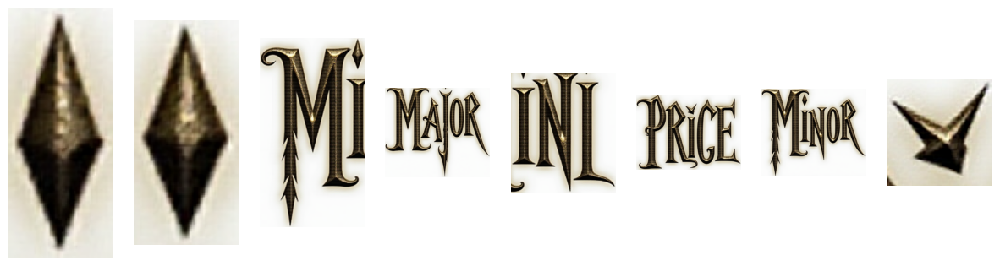

8

In [46]:
import cv2
import numpy as np
from PIL import Image

# Load the image correctly
image_path = "data_prize_words/generated/PRICE_a4b1a.png"  # Replace with your actual image path
image = Image.open(image_path).convert("RGB")  # Open as a PIL image

# Convert PIL Image to OpenCV format (NumPy array)
image_cv = np.array(image)  # Convert PIL to NumPy array (RGB)
image_cv = cv2.cvtColor(image_cv, cv2.COLOR_RGB2BGR)  # Convert RGB to BGR (OpenCV format)

# Convert to grayscale
gray = cv2.cvtColor(image_cv, cv2.COLOR_BGR2GRAY)
_, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV)

# Use morphological operations to remove small noise and connect letters
kernel = np.ones((5, 5), np.uint8)
morphed = cv2.dilate(thresh, kernel, iterations=2)

# Find contours of the text
contours, _ = cv2.findContours(morphed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Get bounding boxes sorted top-to-bottom, left-to-right
bounding_boxes = [cv2.boundingRect(c) for c in contours]
bounding_boxes = sorted(bounding_boxes, key=lambda x: (x[1], x[0]))

# Filter out small noise by size
filtered_boxes = [box for box in bounding_boxes if box[2] > 50 and box[3] > 50]

# Crop and save each detected word separately
cropped_images = []
for (x, y, w, h) in filtered_boxes:
    word_crop = image_cv[y:y+h, x:x+w]  # Crop the word
    word_image = Image.fromarray(cv2.cvtColor(word_crop, cv2.COLOR_BGR2RGB))  # Convert back to PIL format
    cropped_images.append(word_image)

# Display the cropped words for verification
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, len(cropped_images), figsize=(15, 5))
for ax, img in zip(axes, cropped_images):
    ax.imshow(img)
    ax.axis("off")

plt.show()

# Check number of detected words
len(cropped_images)

In [33]:
# # Example usage for a single image
single_prompt = """
"The stylized words 'MAJOR,' 'MINI,' 'MINOR,' and 'PRICE' are made in the same **cyberpunk aesthetic**, 
using a glowing neon texture with a high-tech, futuristic look. Each word should be large, bold, and uniform in size, 
designed with sleek, angular edges and subtle **digital glitch effects** to enhance the cyberpunk feel. 
The letters should have a smooth, illuminated appearance with a metallic sheen, featuring **electric blue** as the primary color, 
complemented by **neon magenta and cyan highlights**. A subtle glow surrounds each word, giving a **holographic, digital display** effect.

The words must be arranged in a **perfect 2x2 grid**, evenly spaced and aligned without rotation:
- 'MAJOR' is in the **upper-left corner**.
- 'MINI' is in the **upper-right corner**.
- 'MINOR' is in the **lower-left corner**.
- 'PRICE' is in the **lower-right corner**.

To prevent excessive shrinking, the words should be **positioned slightly lower**, leaving more negative space at the top 
while still maintaining balance in the composition. The font weight and letter spacing should ensure **readability and a strong, futuristic presence**.

The background is completely **pure white**, with no shadows, gradients, or textures, ensuring the words are perfectly isolated 
and contrast against the background. The entire composition is clean, high-tech, and visually engaging."
"""
single_image_path = generate_single_image(prompt=single_prompt, word='PRICE', gen_params=gen_params)

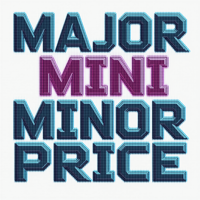

In [36]:
Image.open(single_image_path).resize((200, 200))

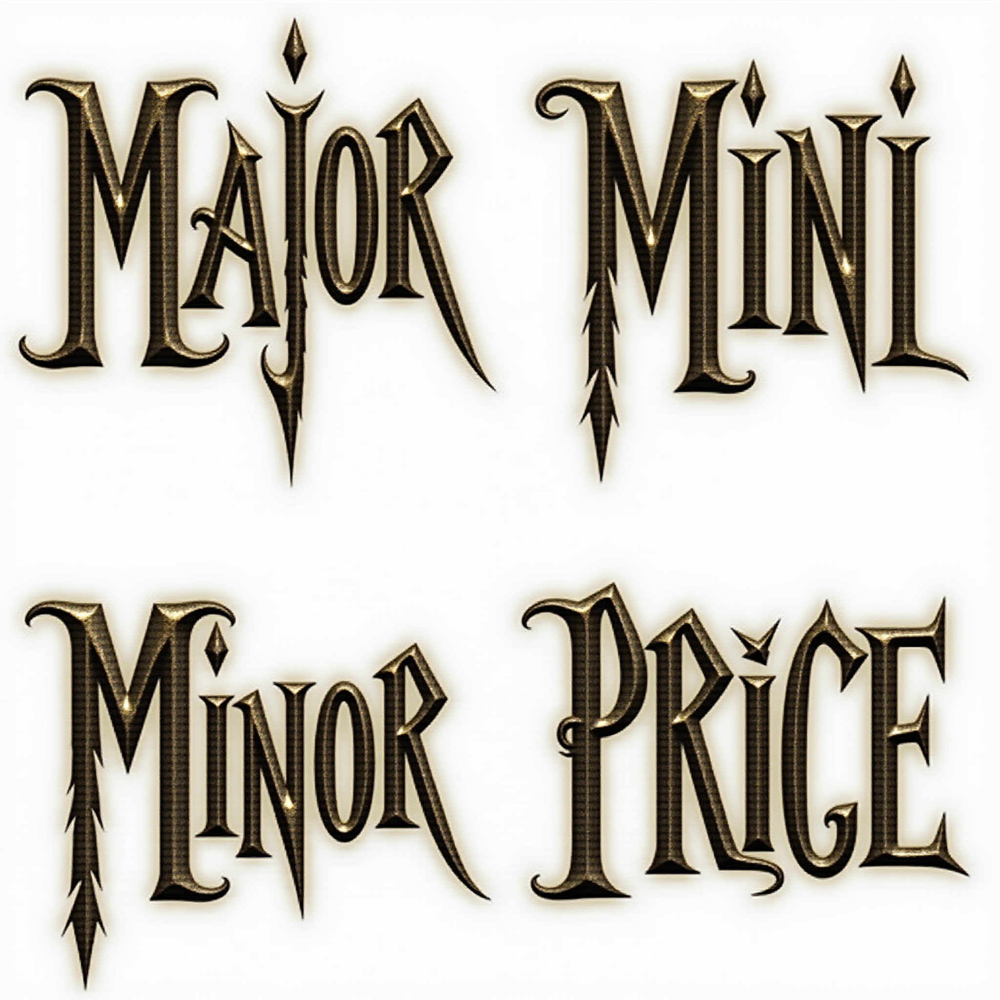

In [30]:
Image.open(single_image_path)

In [ ]:
Image.open(single_image_path)

# Try nice prompts

### 1024

In [16]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a chilling, slasher-horror aesthetic, inspired by Friday the 13th. The letters have jagged, rough edges, as if carved by a knife, with eerie, blood-red streaks running down their surfaces. The texture mimics aged, weathered metal, reminiscent of old, rusted weapons, giving them a sinister feel. Shadows and scratches add depth, making the words look like they have survived countless nightmares.
The main colors are deep crimson, black, and dark silver, evoking blood, darkness, and cold steel. Small, subtle splatters of red ink or dripping blood appear on the edges, enhancing the horror effect. 

Each word is **isolated and clearly visible against a stark white background**, ensuring maximum contrast and clarity. There are no additional background elements—only the words themselves stand out in their terrifying form. 

The word “MAJOR” is positioned in the upper left corner, standing bold and threatening. “MINI” is in the upper right, its letters slightly distorted, as if whispering from the shadows. “MINOR” lurks in the lower left, its form appearing scratched and clawed. “PRICE” dominates the lower right, its letters dripping ominously, hinting at a terrifying cost yet to be paid.

This design captures the **slasher horror essence**, perfect for invoking fear and unease while remaining visually striking on a clean, high-contrast white background.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (1024, 1024)
}

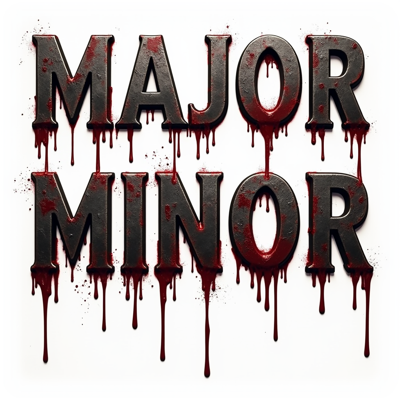

In [17]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((400, 400))

#### 2048

In [18]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a chilling, slasher-horror aesthetic, inspired by Friday the 13th. The letters have jagged, rough edges, as if carved by a knife, with eerie, blood-red streaks running down their surfaces. The texture mimics aged, weathered metal, reminiscent of old, rusted weapons, giving them a sinister feel. Shadows and scratches add depth, making the words look like they have survived countless nightmares.
The main colors are deep crimson, black, and dark silver, evoking blood, darkness, and cold steel. Small, subtle splatters of red ink or dripping blood appear on the edges, enhancing the horror effect. 

Each word is **isolated and clearly visible against a stark white background**, ensuring maximum contrast and clarity. There are no additional background elements—only the words themselves stand out in their terrifying form. 

The word “MAJOR” is positioned in the upper left corner, standing bold and threatening. “MINI” is in the upper right, its letters slightly distorted, as if whispering from the shadows. “MINOR” lurks in the lower left, its form appearing scratched and clawed. “PRICE” dominates the lower right, its letters dripping ominously, hinting at a terrifying cost yet to be paid.

This design captures the **slasher horror essence**, perfect for invoking fear and unease while remaining visually striking on a clean, high-contrast white background.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

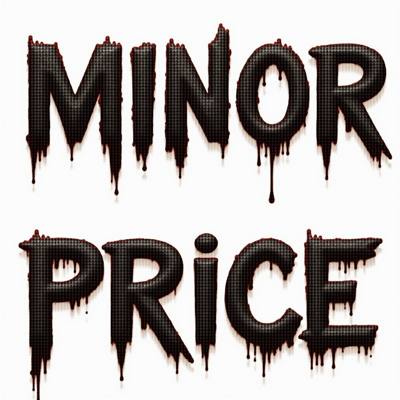

In [19]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((400, 400))

#### More rectanglular 

In [20]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a chilling, slasher-horror aesthetic, inspired by Friday the 13th. The letters have jagged, rough edges, as if carved by a knife, with eerie, blood-red streaks running down their surfaces. The texture mimics aged, weathered metal, reminiscent of old, rusted weapons, giving them a sinister feel. Shadows and scratches add depth, making the words look like they have survived countless nightmares.
The main colors are deep crimson, black, and dark silver, evoking blood, darkness, and cold steel. Small, subtle splatters of red ink or dripping blood appear on the edges, enhancing the horror effect. 

Each word is **isolated and clearly visible against a stark white background**, ensuring maximum contrast and clarity. There are no additional background elements—only the words themselves stand out in their terrifying form. 

The word “MAJOR” is positioned in the upper left corner, standing bold and threatening. “MINI” is in the upper right, its letters slightly distorted, as if whispering from the shadows. “MINOR” lurks in the lower left, its form appearing scratched and clawed. “PRICE” dominates the lower right, its letters dripping ominously, hinting at a terrifying cost yet to be paid.

This design captures the **slasher horror essence**, perfect for invoking fear and unease while remaining visually striking on a clean, high-contrast white background.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2560, 1440)
}

In [21]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

SyntaxError: incomplete input (1369337416.py, line 2)

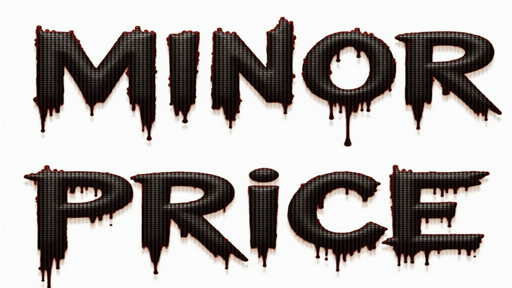

In [24]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a chilling, slasher-horror aesthetic, inspired by Friday the 13th. The letters have jagged, rough edges, as if carved by a knife, with eerie, blood-red streaks running down their surfaces. The texture mimics aged, weathered metal, reminiscent of old, rusted weapons, giving them a sinister feel. Shadows and scratches add depth, making the words look like they have survived countless nightmares.
The main colors are deep crimson, black, and dark silver, evoking blood, darkness, and cold steel. Small, subtle splatters of red ink or dripping blood appear on the edges, enhancing the horror effect. 

Each word is **isolated and clearly visible against a stark white background**, ensuring maximum contrast and clarity. There are no additional background elements—only the words themselves stand out in their terrifying form. 

The word “MAJOR” is positioned in the upper left corner, standing bold and threatening. “MINI” is in the upper right, its letters slightly distorted, as if whispering from the shadows. “MINOR” lurks in the lower left, its form appearing scratched and clawed. “PRICE” dominates the lower right, its letters dripping ominously, hinting at a terrifying cost yet to be paid.

This design captures the **slasher horror essence**, perfect for invoking fear and unease while remaining visually striking on a clean, high-contrast white background.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (3072, 1536)
}

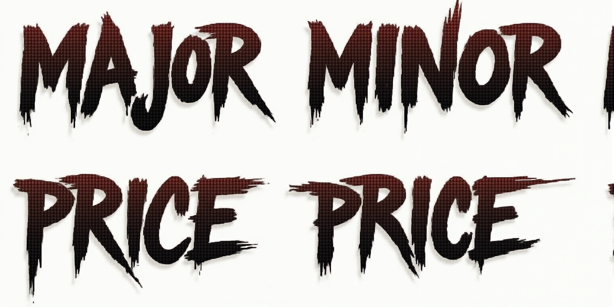

In [25]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [26]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a chilling, slasher-horror aesthetic, inspired by Friday the 13th. The letters have jagged, rough edges, as if carved by a knife, with eerie, blood-red streaks running down their surfaces. The texture mimics aged, weathered metal, reminiscent of old, rusted weapons, giving them a sinister feel. Shadows and scratches add depth, making the words look like they have survived countless nightmares.
The main colors are deep crimson, black, and dark silver, evoking blood, darkness, and cold steel. Small, subtle splatters of red ink or dripping blood appear on the edges, enhancing the horror effect. 

Each word is **isolated and clearly visible against a stark white background**, ensuring maximum contrast and clarity. There are no additional background elements—only the words themselves stand out in their terrifying form. 

The word “MAJOR” is positioned in the upper left corner, standing bold and threatening. “MINI” is in the upper right, its letters slightly distorted, as if whispering from the shadows. “MINOR” lurks in the lower left, its form appearing scratched and clawed. “PRICE” dominates the lower right, its letters dripping ominously, hinting at a terrifying cost yet to be paid.

This design captures the **slasher horror essence**, perfect for invoking fear and unease while remaining visually striking on a clean, high-contrast white background.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 10,
    'resolution': (3072, 1536)
}

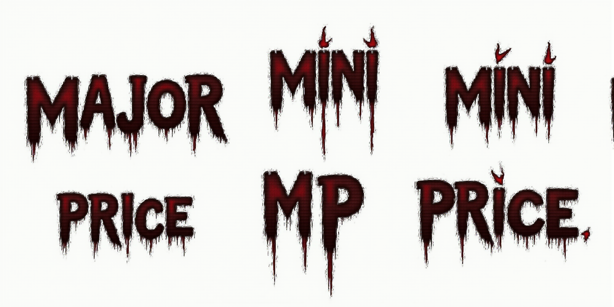

In [27]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [31]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a chilling, slasher-horror aesthetic, inspired by Friday the 13th. The letters have jagged, rough edges, as if carved by a knife, with eerie, blood-red streaks running down their surfaces. The texture mimics aged, weathered metal, reminiscent of old, rusted weapons, giving them a sinister feel. Shadows and scratches add depth, making the words look like they have survived countless nightmares.
The main colors are deep crimson, black, and dark silver, evoking blood, darkness, and cold steel. Small, subtle splatters of red ink or dripping blood appear on the edges, enhancing the horror effect. 

Each word is **isolated and clearly visible against a stark white background**, ensuring maximum contrast and clarity. There are no additional background elements—only the words themselves stand out in their terrifying form. 

The word “MAJOR” is positioned in the upper left corner, standing bold and threatening. “MINI” is in the upper right, its letters slightly distorted, as if whispering from the shadows. “MINOR” lurks in the lower left, its form appearing scratched and clawed. “PRICE” dominates the lower right, its letters dripping ominously, hinting at a terrifying cost yet to be paid.

This design captures the **slasher horror essence**, perfect for invoking fear and unease while remaining visually striking on a clean, high-contrast white background.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 21,
    'resolution': (3072, 1536)
}

In [32]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

ValueError: Bad response from FLUX API. Status code: 500

In [33]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a chilling, slasher-horror aesthetic, inspired by Friday the 13th. The letters have jagged, rough edges, as if carved by a knife, with eerie, blood-red streaks running down their surfaces. The texture mimics aged, weathered metal, reminiscent of old, rusted weapons, giving them a sinister feel. Shadows and scratches add depth, making the words look like they have survived countless nightmares.
The main colors are deep crimson, black, and dark silver, evoking blood, darkness, and cold steel. Small, subtle splatters of red ink or dripping blood appear on the edges, enhancing the horror effect. 

Each word is **isolated and clearly visible against a stark white background**, ensuring maximum contrast and clarity. There are no additional background elements—only the words themselves stand out in their terrifying form. 

The word “MAJOR” is positioned in the upper left corner, standing bold and threatening. “MINI” is in the upper right, its letters slightly distorted, as if whispering from the shadows. “MINOR” lurks in the lower left, its form appearing scratched and clawed. “PRICE” dominates the lower right, its letters dripping ominously, hinting at a terrifying cost yet to be paid.

This design captures the **slasher horror essence**, perfect for invoking fear and unease while remaining visually striking on a clean, high-contrast white background.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (3072, 1024)
}

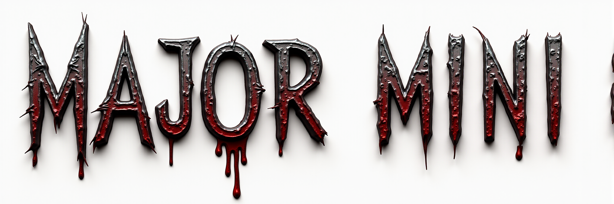

In [34]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [36]:
print('hi')

hi


In [45]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in an elegant and festive New Year aesthetic, inspired by grand countdowns, fireworks, and luxurious party decorations. Each word should be large, bold, and uniform in size, featuring a sophisticated modern calligraphy or Art Deco-style lettering that reflects the glamour and excitement of New Year’s Eve celebrations.
The letters should have metallic gold, silver, or champagne accents, creating a shimmering, reflective effect, as if glowing under a dazzling city skyline or a ballroom chandelier. Delicate sparkles, starbursts, and tiny fireworks subtly embellish the edges, enhancing the celebratory atmosphere. Some letters may incorporate subtle balloon-like curves or ribbon swirls, reminiscent of party streamers and confetti floating in the air.

The words must be arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation:
	•	“MAJOR” is in the upper-left corner.
	•	“MINI” is in the upper-right corner.
	•	“MINOR” is in the lower-left corner.
	•	“PRICE” is in the lower-right corner.

To maintain a festive yet balanced look, the words should be positioned slightly lower, leaving a bit more negative space at the top while still maintaining a harmonious composition. The font should capture the elegance and excitement of New Year’s Eve, incorporating details like gold dust gradients, subtle champagne bubble textures, or celebratory swirls.
The background is completely pure white, ensuring that the words remain isolated and stand out crisply, without any additional shadows, gradients, or patterns. The overall composition should be vibrant, luxurious, and full of New Year’s magic, evoking a sense of excitement, celebration, and new beginnings.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

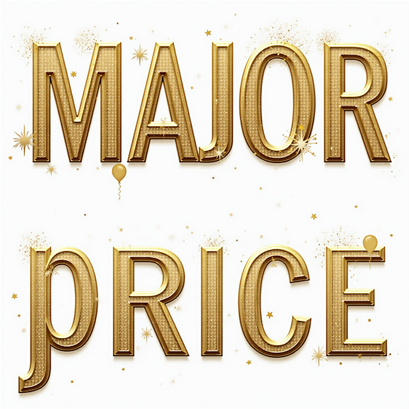

In [46]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [47]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a fun, wacky, and cartoonish aesthetic, inspired by the SpongeBob SquarePants universe. Each word should be bold, playful, and slightly irregular in size and shape, as if they are underwater and have absorbed a bit of the ocean’s quirkiness.

The letters should have a bubbly, squishy, and slightly wobbly form, resembling underwater coral, sea sponges, or jellyfish-like textures. Each word should have a bright and saturated color palette, featuring oceanic blues, sandy yellows, seaweed greens, or coral pinks, with a subtle wet, glossy shine to make them appear fresh and lively.

The words must be arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation:
	•	“MAJOR” is in the upper-left corner, standing bold and energetic.
	•	“MINI” is in the upper-right corner, looking small but lively.
	•	“MINOR” is in the lower-left corner, slightly wobbly like it’s floating.
	•	“PRICE” is in the lower-right corner, standing strong like a treasure chest.

To enhance the underwater cartoon feel, the letters may have tiny bubbles floating around them, wavy outlines mimicking water currents, or light reflections like sun rays hitting the ocean floor. The font should reflect SpongeBob’s quirky, fun-filled world, with elements like goofy, stretched shapes, comic-style lettering, or silly drop shadows.

The background is completely pure white, ensuring the words are isolated and pop vibrantly without any distractions. The overall design should be fun, goofy, and full of SpongeBob-style energy, evoking the cheerful, silly, and underwater adventure vibe of Bikini Bottom!
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

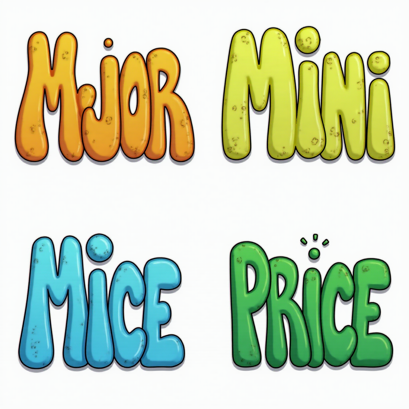

In [48]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [49]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a fun, wacky, and cartoonish aesthetic, inspired by the SpongeBob SquarePants universe. Each word should be bold, playful, and slightly irregular in size and shape, as if they are underwater and have absorbed a bit of the ocean’s quirkiness.

The letters should have a bubbly, squishy, and slightly wobbly form, resembling underwater coral, sea sponges, or jellyfish-like textures. Each word should have a bright and saturated color palette, featuring oceanic blues, sandy yellows, seaweed greens, or coral pinks, with a subtle wet, glossy shine to make them appear fresh and lively.

The words must be arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation:
	•	“MAJOR” is in the upper-left corner, standing bold and energetic.
	•	“MINI” is in the upper-right corner, looking small but lively.
	•	“MINOR” is in the lower-left corner, slightly wobbly like it’s floating.
	•	“PRICE” is in the lower-right corner, standing strong like a treasure chest.

To enhance the underwater cartoon feel, the letters may have tiny bubbles floating around them, wavy outlines mimicking water currents, or light reflections like sun rays hitting the ocean floor. The font should reflect SpongeBob’s quirky, fun-filled world, with elements like goofy, stretched shapes, comic-style lettering, or silly drop shadows.

The background is completely pure white, ensuring the words are isolated and pop vibrantly without any distractions. The overall design should be fun, goofy, and full of SpongeBob-style energy, evoking the cheerful, silly, and underwater adventure vibe of Bikini Bottom!
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

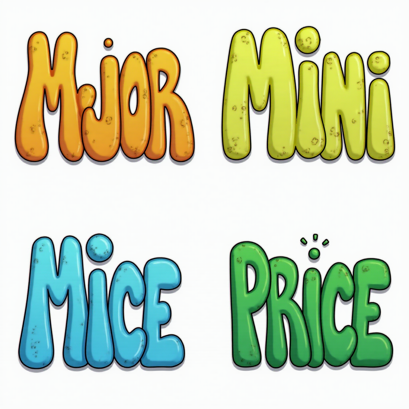

In [50]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [51]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a bold, patriotic, and powerful aesthetic, inspired by the branding and campaign visuals of Donald Trump and the MAGA movement. Each word should be large, commanding, and uniform in size, featuring a strong, all-caps, serif or block-style font that evokes authority, leadership, and American pride.

The letters should incorporate the red, white, and blue color scheme, with accents of gold to represent strength, prosperity, and success. The text should have a polished, embossed effect, resembling the iconic, high-impact typography used in campaign signs, banners, and merchandise. Subtle American flag textures, stars, or eagle motifs can be integrated into the letters, reinforcing the patriotic theme.

The words must be arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation:
	•	“MAJOR” is in the upper-left corner, standing bold and authoritative.
	•	“MINI” is in the upper-right corner, sharp and precise.
	•	“MINOR” is in the lower-left corner, strong but slightly refined.
	•	“PRICE” is in the lower-right corner, exuding confidence and determination.

The font should reflect a classic American campaign style, with elements like bold drop shadows, sharp edges, and clean lines, ensuring the words radiate strength, confidence, and leadership.

The background is completely pure white, ensuring the words remain isolated and stand out powerfully, without any additional textures or distractions. The overall composition should be patriotic, powerful, and reminiscent of American greatness, evoking the energy of a presidential rally, a nationalistic vision, and the bold confidence of Trump-era USA branding.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

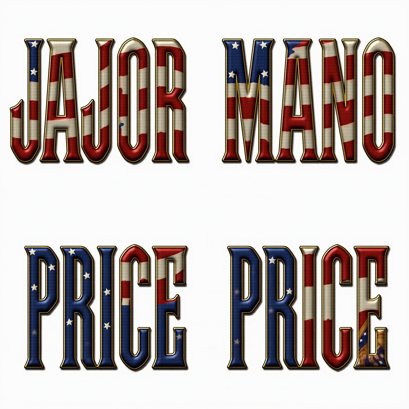

In [52]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [53]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a dynamic, action-packed Spider-Man aesthetic, inspired by the iconic Marvel superhero. Each word should be bold, energetic, and slightly stretched, mimicking the web-slinging motion of Spider-Man swinging between skyscrapers.

The letters should have a sleek, comic-book-style font with sharp edges and dynamic movement, as if they are in mid-action. The primary colors should be deep red and electric blue, accented with black web patterns or subtle comic-style halftone textures. The words should feel like they are straight out of a Spider-Man comic book or animated multiverse, with bold outlines, slight distortion, and a high-energy effect.

The words must be arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation:
	•	“MAJOR” is in the upper-left corner, striking and bold.
	•	“MINI” is in the upper-right corner, slightly agile and sleek.
	•	“MINOR” is in the lower-left corner, with a subtle webbed effect.
	•	“PRICE” is in the lower-right corner, powerful and impactful.

To enhance the Spider-Man comic feel, the letters may have subtle webbing woven into them, a glowing neon-like effect from Spider-Verse animations, or a graffiti-styled urban edge reminiscent of Miles Morales’ world. The font should embody fast-paced movement, superhero energy, and the thrilling, adventurous essence of Spider-Man.

The background is completely pure white, ensuring the words remain isolated and stand out crisply, with no distractions, shadows, or extra elements. The overall composition should be bold, heroic, and full of web-slinging action, evoking the excitement and adrenaline rush of Spider-Man swinging through New York City!
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

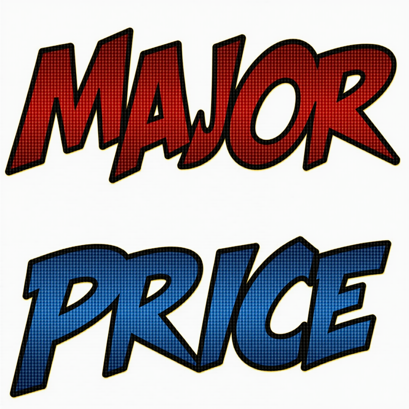

In [54]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [59]:
words_prompt = """
Make image with 4 words on one image. The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a dynamic, action-packed Spider-Man aesthetic, inspired by the iconic Marvel superhero. Each word should be bold, energetic, and slightly stretched, mimicking the web-slinging motion of Spider-Man swinging between skyscrapers.

The words should have a sleek, comic-book-style font with sharp edges and dynamic movement, as if they are in mid-action. The primary colors should be deep red and electric blue, accented with black web patterns or subtle comic-style halftone textures. The words should feel like they are straight out of a Spider-Man comic book or animated multiverse, with bold outlines, slight distortion, and a high-energy effect.

The words must be arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation:
	•	“MAJOR” is in the upper-left corner, striking and bold.
	•	“MINI” is in the upper-right corner, slightly agile and sleek.
	•	“MINOR” is in the lower-left corner, with a subtle webbed effect.
	•	“PRICE” is in the lower-right corner, powerful and impactful.

To enhance the Spider-Man comic feel, the letters may have subtle webbing woven into them, a glowing neon-like effect from Spider-Verse animations, or a graffiti-styled urban edge reminiscent of Miles Morales’ world. The font should embody fast-paced movement, superhero energy, and the thrilling, adventurous essence of Spider-Man.

The background is completely pure white, ensuring the words remain isolated and stand out crisply, with no distractions, shadows, or extra elements. The overall composition should be bold, heroic, and full of web-slinging action, evoking the excitement and adrenaline rush of Spider-Man swinging through New York City!
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

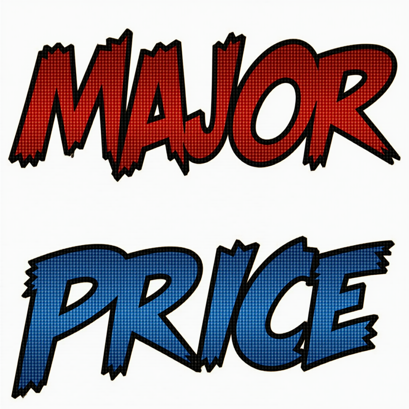

In [60]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [61]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” are designed in a fun, swampy, and fairytale-inspired Shrek aesthetic, embracing the quirky and medieval charm of the Shrek universe. Each word should be large, bold, and uniform in size, featuring a fantasy-style medieval or fairy tale lettering, similar to the iconic Shrek title font.

The letters should have a textured, organic look, as if they were carved from old, moss-covered wood or shaped from mud, stone, or magical swamp energy. The colors should be lush, earthy greens, with golden, brown, and rustic accents, creating a warm and whimsical enchanted forest feel. Some letters can have subtle vine or moss details, giving them an overgrown, mystical touch.

The words must be arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation:
	•	“MAJOR” is in the upper-left corner, bold and heroic.
	•	“MINI” is in the upper-right corner, smaller but mischievous.
	•	“MINOR” is in the lower-left corner, with a slightly tilted, playful feel.
	•	“PRICE” is in the lower-right corner, strong and mystical.

To enhance the Shrek fairy tale magic, the letters may have a soft glowing effect, as if enchanted by an ogre’s charm. Tiny sparkles, swamp bubbles, or fairy dust may float around, reinforcing the mystical yet humorous feel. Some letters could even have tiny ears like Shrek’s or a playful Donkey-inspired twist, making them feel truly part of the swampy kingdom.

The background is completely pure white, ensuring the words remain isolated and clearly visible, with no shadows, gradients, or distractions. The overall composition should feel fun, magical, and slightly goofy, evoking the classic, lighthearted, and adventure-filled spirit of Shrek’s fairy tale world.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

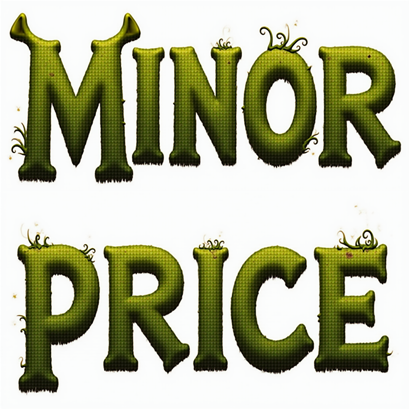

In [62]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [63]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” **must all be clearly visible** in the image, arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation.

Each word is large, bold, and uniform in size, featuring a fantasy-style medieval or fairy tale lettering, similar to the iconic Shrek title font.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no distractions.

Each word is positioned exactly as follows:
- **“MAJOR”** in the upper-left corner, bold and heroic.
- **“MINI”** in the upper-right corner, smaller but mischievous.
- **“MINOR”** in the lower-left corner, with a slightly tilted, playful feel.
- **“PRICE”** in the lower-right corner, strong and mystical.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""

gen_params = {
    'num_inference_steps': 28, 
    'guidance_scale': 3.5,
    'seed': 1,
    'resolution': (2048, 2048)
}

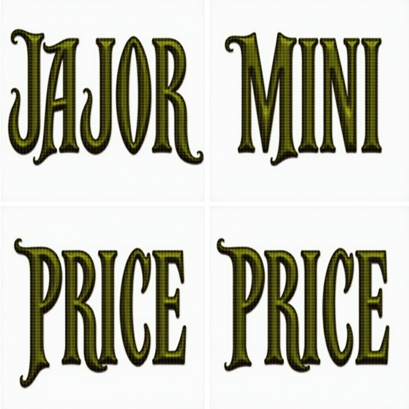

In [64]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [65]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” **must all be clearly visible** in the image, arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation.

Each word is large, bold, and uniform in size, featuring a fantasy-style medieval or fairy tale lettering, similar to the iconic Shrek title font.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no distractions.

Each word is positioned exactly as follows:
- **“MAJOR”** in the upper-left corner, bold and heroic.
- **“MINI”** in the upper-right corner, smaller but mischievous.
- **“MINOR”** in the lower-left corner, with a slightly tilted, playful feel.
- **“PRICE”** in the lower-right corner, strong and mystical.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""

gen_params = {
    'num_inference_steps': 50, 
    'guidance_scale': 7.0,
    'seed': 1,
    'resolution': (2048, 2048)
}

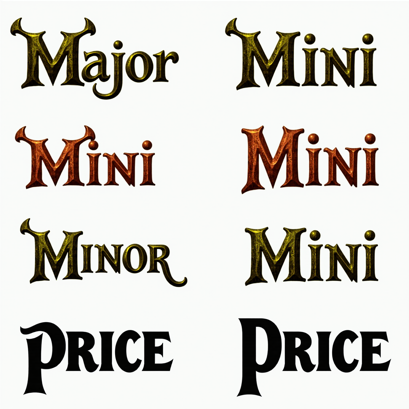

In [66]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [67]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” **must all be clearly visible** in the image, arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation.

Each word is large, bold, and uniform in size, featuring a fantasy-style medieval or fairy tale lettering, similar to the iconic Shrek title font.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no distractions.

Each word is positioned exactly as follows:
- **“MAJOR”** in the upper-left corner, bold and heroic.
- **“MINI”** in the upper-right corner, smaller but mischievous.
- **“MINOR”** in the lower-left corner, with a slightly tilted, playful feel.
- **“PRICE”** in the lower-right corner, strong and mystical.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""

gen_params = {
    'num_inference_steps': 50, 
    'guidance_scale': 7.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

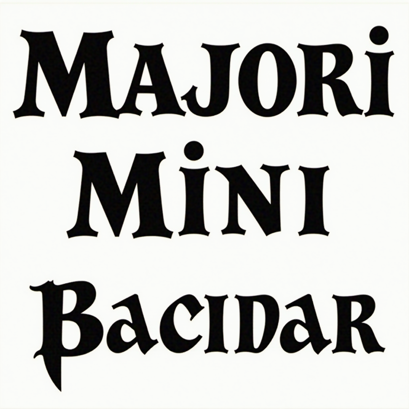

In [68]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [69]:
words_prompt = """
The stylized words “MAJOR,” “MINI,” “MINOR,” and “PRICE” **must all be clearly visible** in the image, arranged in a perfect 2x2 grid, evenly spaced and aligned without rotation.

Each word is large, bold, and uniform in size, featuring a fantasy-style medieval or fairy tale lettering, similar to the iconic Shrek title font.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no distractions.

Each word is positioned exactly as follows:
- **“MAJOR”** in the upper-left corner, bold and heroic.
- **“MINI”** in the upper-right corner, smaller but mischievous.
- **“MINOR”** in the lower-left corner, with a slightly tilted, playful feel.
- **“PRICE”** in the lower-right corner, strong and mystical.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""

gen_params = {
    'num_inference_steps': 50, 
    'guidance_scale': 7.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

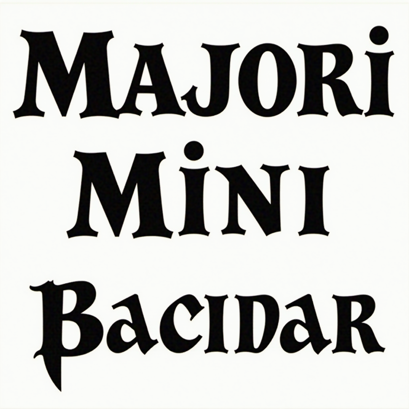

In [70]:
single_image_path = generate_single_image(prompt=words_prompt, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [71]:
words_prompt_mini_minor = """
The stylized words “MINI” and “MINOR” **must both be clearly visible** in the image, arranged side by side in a **perfect horizontal alignment**, evenly spaced and aligned without rotation.

Each word is large, bold, and uniform in size, featuring a fantasy-style medieval or fairy tale lettering, similar to the iconic Shrek title font.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no distractions.

Each word is positioned exactly as follows:
- **“MINI”** on the **left**, appearing slightly mischievous and playful.
- **“MINOR”** on the **right**, with a slightly tilted, whimsical feel.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""

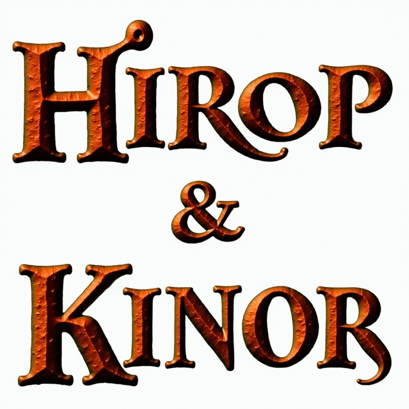

In [72]:
single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [73]:
words_prompt_major_price = """
The stylized words “MAJOR” and “PRICE” **must both be clearly visible** in the image, arranged side by side in a **perfect horizontal alignment**, evenly spaced and aligned without rotation.

Each word is large, bold, and uniform in size, featuring a fantasy-style medieval or fairy tale lettering, similar to the iconic Shrek title font.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no distractions.

Each word is positioned exactly as follows:
- **“MAJOR”** on the **left**, bold and heroic.
- **“PRICE”** on the **right**, strong and mystical.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""

In [ ]:
single_image_path = generate_single_image(prompt=words_prompt_major_price, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [ ]:
words_prompt_mini_minor = """
The stylized words “MINI” and “MINOR” **must both be clearly visible** in the image, arranged side by side in a **perfect horizontal alignment**, evenly spaced and aligned without rotation.

Each word is large, bold, and uniform in size, featuring **elegant, gothic-style lettering**, inspired by the wizarding world of **Harry Potter**. The typography should resemble **ancient enchanted scripts**, blending **medieval magic with a mystical aura**.

The letters should have **subtle golden or silver metallic accents**, reflecting the **legendary inscriptions found in Hogwarts**. A **soft, mystical glow or aura** surrounds the letters, enhancing their **enchanted** appearance.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no shadows, gradients, or textures.

Each word is positioned exactly as follows:
- **“MINI”** on the **left**, appearing playful and mischievous, as if it belongs to a magical spellbook.
- **“MINOR”** on the **right**, with a slightly mystical, runic embellishment, giving it a sense of ancient power.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""
single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [ ]:
words_prompt_major_price = """
The stylized words “MAJOR” and “PRICE” **must both be clearly visible** in the image, arranged side by side in a **perfect horizontal alignment**, evenly spaced and aligned without rotation.

Each word is large, bold, and uniform in size, featuring **mystical, gothic-style lettering**, inspired by the **Harry Potter universe**. The typography should reflect **wizardly elegance**, infused with **runic magic and medieval enchantments**.

The letters should include **subtle golden or silver metallic detailing**, reminiscent of **ancient magical texts from Hogwarts' archives**. A **mystical aura, faint magical sparks, or a soft glowing outline** enhances the spellbinding atmosphere.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no shadows, gradients, or textures.

Each word is positioned exactly as follows:
- **“MAJOR”** on the **left**, bold and powerful, resembling a grand spell engraved on an enchanted book.
- **“PRICE”** on the **right**, exuding a sense of arcane wisdom, as if it holds the secrets of wizardry.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""
single_image_path = generate_single_image(prompt=words_prompt_major_price, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [ ]:
words_prompt_mini_minor = """
The stylized words “MINI” and “MINOR” **must both be clearly visible** in the image, arranged side by side in a **perfect horizontal alignment**, evenly spaced and aligned without rotation.

Each word is **large, bold, and uniform in size**, featuring a **festive, elegant holiday-themed font** inspired by the magic of **Christmas and New Year's celebrations**. The typography should have a joyful and **whimsical holiday feel**, with decorative elements evoking warmth, celebration, and festivity.

The letters should have **rich holiday colors**, primarily **deep red, gold, and frosty white**, accented with **sparkling snow, twinkling lights, or soft glows**, capturing the magic of the season. The words can feature **subtle candy cane stripes, golden holiday ribbons, or pine tree patterns**.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no distractions.

Each word is positioned exactly as follows:
- **“MINI”** on the **left**, playful and lighthearted, evoking a joyful Christmas spirit.
- **“MINOR”** on the **right**, decorated with frosty winter magic, as if dusted with fresh snow.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""
single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [ ]:
words_prompt_major_price = """
The stylized words “MAJOR” and “PRICE” **must both be clearly visible** in the image, arranged side by side in a **perfect horizontal alignment**, evenly spaced and aligned without rotation.

Each word is **large, bold, and uniform in size**, featuring a **luxurious, holiday-inspired font** with a grand **New Year’s Eve celebration aesthetic**. The typography should radiate **elegance, festivity, and seasonal joy**, reminiscent of **golden countdown clocks, champagne bubbles, and winter wonderland magic**.

The letters should have **a sophisticated gold and silver metallic shimmer**, symbolizing **New Year glamour and holiday excitement**. Subtle **firework sparkles, confetti swirls, or decorative frost edges** should enhance the festive mood.

The background is completely **pure white**, ensuring the words remain isolated and clearly visible, with no shadows, gradients, or distractions.

Each word is positioned exactly as follows:
- **“MAJOR”** on the **left**, bold and striking, resembling an illuminated marquee at a grand New Year’s event.
- **“PRICE”** on the **right**, glowing elegantly, as if bathed in the sparkling light of a festive celebration.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

If any of the words are missing or incomplete, the image is incorrect and must be re-generated.
"""

gen_params = {
    'num_inference_steps': 50, 
    'guidance_scale': 7.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

single_image_path = generate_single_image(prompt=words_prompt_major_price, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

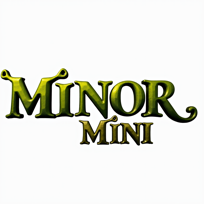

In [12]:
words_prompt_mini_minor = """
The stylized words **"MINOR" and "MINI"** **must both be clearly visible** in the image, arranged **one on top of the other in a perfect vertical alignment**, evenly spaced and aligned **without rotation**.

Each word is **large, bold, and uniform in size**, featuring a **fantasy-style medieval or fairy tale lettering**, similar to the **iconic Shrek title font**.

The background is completely **pure white**, ensuring the words remain **isolated and clearly visible**, with no distractions.

Each word is positioned **exactly as follows**:
- **“MINOR”** on the **top**, appearing strong and mystical.
- **“MINI”** on the **bottom**, slightly playful and mischievous.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

**Important:** The image **must not contain any extra words**. Only **"MINOR" and "MINI"** should be present in the design. If any extra words appear, the image is incorrect and must be re-generated.
"""

gen_params = {
    'num_inference_steps': 50, 
    'guidance_scale': 5.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

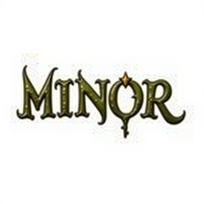

In [14]:
words_prompt_mini_minor = """
The stylized words **"MINOR" and "MINI"** **must both be clearly visible** in the image, arranged **one on top of the other in a perfect vertical alignment**, evenly spaced and aligned **without rotation**.

Each word is **large, bold, and uniform in size**, featuring a **fantasy-style medieval or fairy tale lettering**, similar to the **iconic Shrek title font**.

The background is completely **pure white**, ensuring the words remain **isolated and clearly visible**, with no distractions.

Each word is positioned **exactly as follows**:
- **“MINOR”** on the **top**, appearing strong and mystical.
- **“MINI”** on the **bottom**, slightly playful and mischievous.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

**Important:** The image **must not contain any extra words**. Only **"MINOR" and "MINI"** should be present in the design. If any extra words appear, the image is incorrect and must be re-generated.
"""

gen_params = {
    'num_inference_steps': 20, 
    'guidance_scale': 5.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

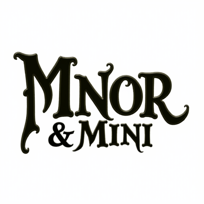

In [17]:
words_prompt_mini_minor = """
The stylized words **"MINOR" and "MINI"** **must both be clearly visible** in the image, arranged **one on top of the other in a perfect vertical alignment**, evenly spaced and aligned **without rotation**.

Each word is **large, bold, and uniform in size**, featuring a **fantasy-style medieval or fairy tale lettering**, similar to the **iconic Shrek title font**.

The background is completely **pure white**, ensuring the words remain **isolated and clearly visible**, with no distractions.

Each word is positioned **exactly as follows**:
- **“MINOR”** on the **top**, appearing strong and mystical.
- **“MINI”** on the **bottom**, slightly playful and mischievous.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

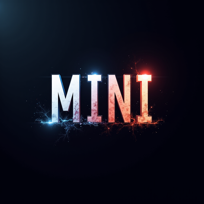

In [19]:
words_prompt_mini_minor = """
Create an artistic composition featuring the words 'MINI' and 'MAJOR' separately in the same image. 
Each word should have its own distinct style: 'MINI' should be designed in a small, minimalist, and modern font, 
while 'MAJOR' should be bold, grand, and striking. The typography should be visually contrasting yet harmonious in 
the overall composition. The background should complement both text styles with a sleek and dynamic aesthetic. 
Use high contrast, dynamic lighting, and a futuristic or high-end graphic design approach. --v 5 --ar 16:9
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

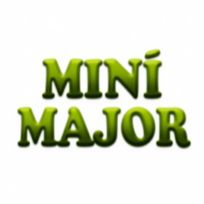

In [20]:
words_prompt_mini_minor = """
A clean, high-resolution digital typography design featuring the words ‘MINI’ and ‘MAJOR’ in the same bold, playful, and slightly medieval Shrek-style font. The letters are thick, slightly irregular, and have a subtle 3D effect with a soft green gradient reminiscent of the Shrek logo. Each word is identical in size and style, positioned clearly on a pure white background. The text has a slight glossy or embossed look, making it pop while maintaining a simple and cohesive aesthetic. No additional decorations or shadows beyond the necessary depth for realism.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

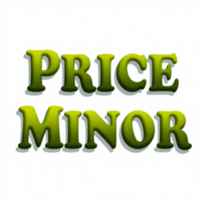

In [21]:
words_prompt_mini_minor = """
A clean, high-resolution digital typography design featuring the words ‘PRICE’ and ‘MINOR’ in the same bold, playful, and slightly medieval Shrek-style font. The letters are thick, slightly irregular, and have a subtle 3D effect with a soft green gradient reminiscent of the Shrek logo. Each word is identical in size and style, positioned clearly on a pure white background. The text has a slight glossy or embossed look, making it pop while maintaining a simple and cohesive aesthetic. No additional decorations or shadows beyond the necessary depth for realism.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [ ]:
words_prompt_mini_minor = """
A clean, high-resolution digital typography design featuring the words ‘PRICE’ and ‘MINOR’ in the same bold, playful, and slightly medieval Shrek-style font. The letters are thick, slightly irregular, and have a subtle 3D effect with a soft green gradient reminiscent of the Shrek logo. Each word is identical in size and style, positioned clearly on a pure white background. The text has a slight glossy or embossed look, making it pop while maintaining a simple and cohesive aesthetic. No additional decorations or shadows beyond the necessary depth for realism.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

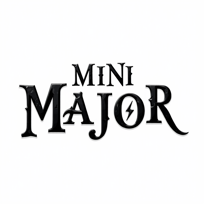

In [22]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘MINI’ and ‘MAJOR’ in the iconic Harry Potter-style font. The letters are sharp, elongated, and slightly gothic with lightning bolt-inspired details, evoking the magical and mystical feel of the series. Both words are identical in size, with elegant serifs and a subtle metallic or aged ink texture. The background is completely white, ensuring a clean, minimalistic look that highlights the typography. No extra elements or distractions, just the bold and wizardly text floating on a pristine backdrop.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

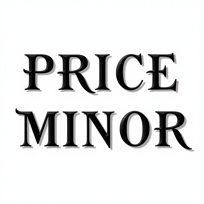

In [23]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in the iconic Harry Potter-style font. The letters are sharp, elongated, and slightly gothic with lightning bolt-inspired details, evoking the magical and mystical feel of the series. Both words are identical in size, with elegant serifs and a subtle metallic or aged ink texture. The background is completely white, ensuring a clean, minimalistic look that highlights the typography. No extra elements or distractions, just the bold and wizardly text floating on a pristine backdrop.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

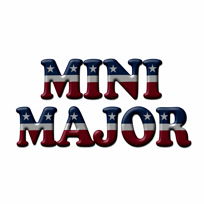

In [24]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘MINI’ and ‘MAJOR’ in a bold, patriotic USA-style font. The letters are strong, blocky, and slightly embossed, inspired by classic Americana aesthetics. The text incorporates elements of the American flag, such as stars and stripes, with a red, white, and blue color scheme. The design is clean, professional, and perfectly aligned, ensuring both words are identical in size and style. The background is fully white, keeping the focus on the typography. No additional distractions, just a crisp and powerful American-themed text representation.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

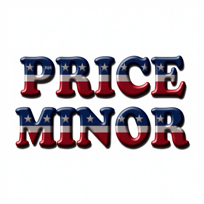

In [25]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, patriotic USA-style font. The letters are strong, blocky, and slightly embossed, inspired by classic Americana aesthetics. The text incorporates elements of the American flag, such as stars and stripes, with a red, white, and blue color scheme. The design is clean, professional, and perfectly aligned, ensuring both words are identical in size and style. The background is fully white, keeping the focus on the typography. No additional distractions, just a crisp and powerful American-themed text representation.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

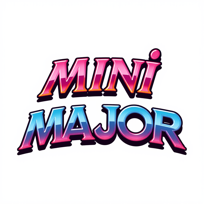

In [26]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘MINI’ and ‘MAJOR’ in a bold, colorful anime-style font. The letters have dynamic, exaggerated shapes with a playful yet sharp aesthetic, inspired by Japanese anime title designs. The text is outlined with a thick stroke and may include gradient shading, glowing edges, or speed lines for an energetic effect. Vibrant colors like neon pink, electric blue, or fiery red enhance the design, creating a lively and eye-catching look. Both words are identical in size and style, ensuring consistency. The background is fully white, making the text stand out vividly without distractions. No extra symbols or additional elements beyond the anime-inspired typography."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [ ]:
‘PRICE’ and ‘MINOR’

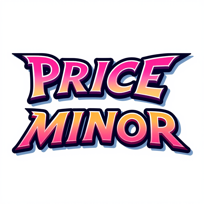

In [27]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, colorful anime-style font. The letters have dynamic, exaggerated shapes with a playful yet sharp aesthetic, inspired by Japanese anime title designs. The text is outlined with a thick stroke and may include gradient shading, glowing edges, or speed lines for an energetic effect. Vibrant colors like neon pink, electric blue, or fiery red enhance the design, creating a lively and eye-catching look. Both words are identical in size and style, ensuring consistency. The background is fully white, making the text stand out vividly without distractions. No extra symbols or additional elements beyond the anime-inspired typography."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

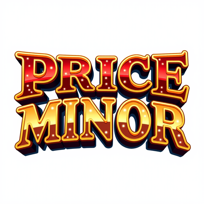

In [10]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, jackpot-winning style font. The letters are dynamic and exaggerated, blending the glamorous aesthetics of casino signage with a playful anime edge. The text has thick, golden outlines with embedded sparkles, giving it a luxurious, high-stakes feel. Gradient shading mimics the glow of neon lights, while shimmering highlights add a jackpot-winning effect. The colors are vibrant and eye-catching, with rich gold, deep red, and electric blue, resembling the thrill of hitting the jackpot. The background remains fully white to make the text pop vividly. No extra symbols or distractions—just pure casino-meets-anime typography energy."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

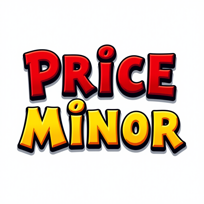

In [11]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, Mickey Mouse-style font. The letters have a whimsical, rounded, and cartoonish look, inspired by classic Disney typography. The font is playful with soft, bouncy curves and a friendly, vintage animation feel. The text is outlined with a thick black stroke, enhancing its storybook charm. The colors are bright and cheerful, featuring classic Mickey-inspired hues like bold red, sunny yellow, and deep black. Subtle white highlights add a glossy, animated effect, making the text look like it belongs in a lively cartoon scene. The background remains fully white, ensuring the words stand out vividly without distractions. No extra symbols or elements—just pure Disney-style, vintage animation typography."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

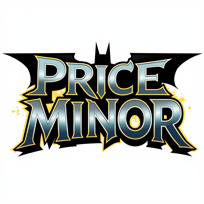

In [12]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, Batman-style font. The letters have a sharp, angular, and heroic look, inspired by the iconic comic book and movie title designs. The font is bold and dynamic, with dramatic, jagged edges and a slightly gothic flair that evokes the Dark Knight aesthetic. The text is outlined with a thick black stroke, enhancing its shadowy, crime-fighting feel. Colors are deep and intense, featuring steely grays, electric yellow, and dark blue or black, similar to the Bat-Signal’s glow against the night sky. Subtle gradients and shadow effects create a sense of depth and mystery, making the letters feel like they are emerging from the darkness. The background remains fully white, allowing the typography to stand out with a bold, Gotham-inspired presence. No extra symbols or elements—just pure Batman-style comic book typography."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

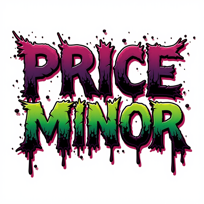

In [13]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, Joker-style font. The letters have a chaotic, distorted, and maniacal look, inspired by the Joker’s eerie yet playful aesthetic from comics and films. The font is irregular and slightly twisted, with sharp, exaggerated strokes, uneven edges, and a sinister yet whimsical feel. The text is outlined with a bold, jagged stroke, enhancing its unpredictable, anarchic energy. Colors are wild and vibrant, featuring deep purples, toxic greens, blood reds, and sinister blacks, capturing the Joker’s signature color scheme. Glowing highlights, dripping paint effects, or spray-paint textures add to the unhinged, graffiti-like look, making the words feel like they were scrawled in a fit of madness. The background remains fully white, ensuring the typography pops in all its chaotic glory. No extra symbols or elements—just pure Joker-style, twisted comic book typography."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

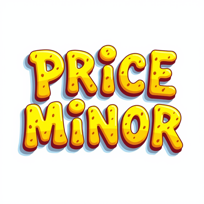

In [14]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, SpongeBob-style font. The letters have a wobbly, bubbly, and playful underwater look, inspired by the classic SpongeBob SquarePants logo. The font is cartoonish and fun, with slightly irregular, bouncy shapes that feel like they’re floating underwater. The text is outlined with a thick, bold stroke, enhancing its cheerful and goofy energy. The colors are bright and tropical, featuring sunny yellows, ocean blues, and coral oranges, evoking the vibrant Bikini Bottom atmosphere. Subtle drop shadows and bubbly textures add an aquatic, lighthearted feel, making the words look squishy, spongy, or slightly wavy, as if submerged in water. The background remains fully white, ensuring the typography pops with its playful and nautical charm. No extra symbols or elements—just pure SpongeBob-style, fun cartoon typography."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

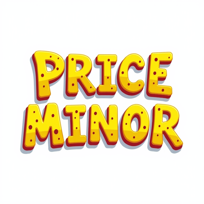

In [20]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, SpongeBob-style font, arranged with clean white space between them. The word ‘PRICE’ is positioned at the top, while ‘MINOR’ is at the bottom, ensuring a balanced composition with a clear gap of negative space in between. The letters have a wobbly, bubbly, and playful underwater look, inspired by the classic SpongeBob SquarePants logo. The font is cartoonish and fun, with slightly irregular, bouncy shapes that feel like they’re floating underwater. The text is outlined with a thick, bold stroke, enhancing its cheerful and goofy energy.

The colors are bright and tropical, featuring sunny yellows, ocean blues, and coral oranges, evoking the vibrant Bikini Bottom atmosphere. Subtle drop shadows and bubbly textures add an aquatic, lighthearted feel, making the words look squishy, spongy, or slightly wavy, as if submerged in water. The background remains fully white, ensuring the typography pops vividly, with clear, unobstructed white space separating the words. No extra symbols or elements—just pure SpongeBob-style, fun cartoon typography with a clean layout."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

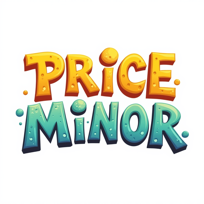

In [25]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, SpongeBob-style font, arranged with clean white space between them. The word ‘PRICE’ is positioned at the top, while ‘MINOR’ is at the bottom, ensuring a balanced composition with a clear gap of negative space in between. The letters have a wobbly, bubbly, and playful underwater look, inspired by the classic SpongeBob SquarePants logo. The font is cartoonish and fun, with slightly irregular, bouncy shapes that feel like they’re floating underwater. The text is outlined with a thick, bold stroke, enhancing its cheerful and goofy energy.

The colors are bright and tropical, featuring sunny yellows, ocean blues, and coral oranges, evoking the vibrant Bikini Bottom atmosphere. Subtle drop shadows and bubbly textures add an aquatic, lighthearted feel, making the words look squishy, spongy, or slightly wavy, as if submerged in water. The background remains fully white, ensuring the typography pops vividly, with clear, unobstructed white space separating the words. No extra symbols or elements—just pure SpongeBob-style, fun cartoon typography with a clean layout."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 30.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

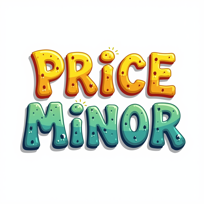

In [26]:
words_prompt_mini_minor = """
A high-resolution typography design featuring the words ‘PRICE’ and ‘MINOR’ in a bold, SpongeBob-style font, arranged with clean white space between them. The word ‘PRICE’ is positioned at the top, while ‘MINOR’ is at the bottom, ensuring a balanced composition with a clear gap of negative space in between. The letters have a wobbly, bubbly, and playful underwater look, inspired by the classic SpongeBob SquarePants logo. The font is cartoonish and fun, with slightly irregular, bouncy shapes that feel like they’re floating underwater. The text is outlined with a thick, bold stroke, enhancing its cheerful and goofy energy.

The colors are bright and tropical, featuring sunny yellows, ocean blues, and coral oranges, evoking the vibrant Bikini Bottom atmosphere. Subtle drop shadows and bubbly textures add an aquatic, lighthearted feel, making the words look squishy, spongy, or slightly wavy, as if submerged in water. The background remains fully white, ensuring the typography pops vividly, with clear, unobstructed white space separating the words. No extra symbols or elements—just pure SpongeBob-style, fun cartoon typography with a clean layout."""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 5.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

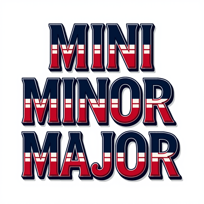

In [27]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, USA-style font. The words are stacked vertically in the center, ensuring a balanced layout with equal spacing between each word. The typography embodies a classic American aesthetic, inspired by patriotic themes, vintage signage, and sports lettering. The font is strong, bold, and all-caps, with a slightly blocky, collegiate, or varsity look reminiscent of American sports teams, old-school posters, or Fourth of July decorations.

The colors reflect the iconic red, white, and blue of the United States, with a deep navy blue base, fiery red accents, and crisp white highlights. Optional elements such as subtle stripes, stars, or faded textures may be incorporated into the lettering, enhancing the authentic USA feel. A thick outline and shadow effects create a bold, high-impact presence, making the words stand out like they belong on an American football jersey, a patriotic banner, or a classic neon diner sign.

The background remains fully white, ensuring that the text pops with clean visibility. No additional symbols or elements—just pure USA-inspired typography, bringing a mix of classic Americana, sports aesthetics, and national pride.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

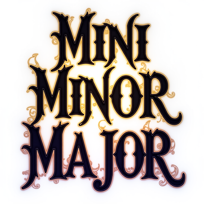

In [28]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, Harry Potter-style font. The words are stacked vertically in the center, ensuring a balanced layout with equal spacing between each word. The typography is inspired by the mystical, gothic, and wizardly aesthetic of the Harry Potter universe, evoking the magic of Hogwarts, enchanted books, and spellbinding scrolls. The font is ornate, slightly elongated, and serif-styled, with sharp, lightning-like accents and an old-world, medieval charm reminiscent of wizarding school inscriptions and ancient spell tomes.

The colors reflect a magical, mystical palette, featuring deep golds, enchanted purples, and shadowy blacks, with optional glowing edges, smoky wisps, or subtle lightning effects to enhance the wizarding atmosphere. Aged textures, glowing highlights, or mystical engravings may subtly blend into the letters, giving them the timeless feel of an enchanted script. A subtle golden glow or swirling magical aura may surround the words, making them appear as if they were conjured from an ancient spellbook.

The background remains fully white, ensuring that the typography pops clearly while maintaining a magical, mystical elegance. No additional symbols or elements—just pure Harry Potter-inspired typography, bringing a mix of fantasy, wizardry, and gothic enchantment.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

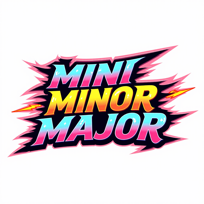

In [29]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, anime-style font. The words are stacked vertically in the center, ensuring a balanced layout with equal spacing between each word. The typography embodies the energetic, dynamic, and eye-catching aesthetic of Japanese anime title designs, inspired by shonen action series, mecha anime, and high-energy opening sequences. The font is bold, exaggerated, and slightly angled, with sharp edges, thick strokes, and a fast-paced, electric feel.

The colors are vibrant and high-contrast, featuring neon pinks, electric blues, fiery reds, and golden yellows, capturing the intensity and excitement of anime visuals. Optional elements such as glowing outlines, motion blur effects, or Japanese katakana-style accents may be incorporated to enhance the authentic anime feel. A thick, colorful stroke around the text, along with subtle lighting effects and action speed lines, gives the words a high-energy, battle-ready look, as if they were part of an explosive anime title screen.

The background remains fully white, ensuring the typography pops with an intense, anime-inspired visual impact. No additional symbols or elements—just pure anime-style typography, bringing a mix of vibrant energy, action-packed excitement, and bold Japanese animation aesthetics.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

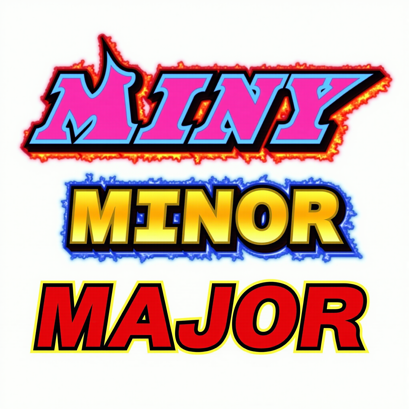

In [31]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, anime-style font. The words are stacked vertically in the center, ensuring a balanced layout with equal spacing between each word. The typography embodies the energetic, dynamic, and eye-catching aesthetic of Japanese anime title designs, inspired by shonen action series, mecha anime, and high-energy opening sequences. The font is bold, exaggerated, and slightly angled, with sharp edges, thick strokes, and a fast-paced, electric feel.

The colors are vibrant and high-contrast, featuring neon pinks, electric blues, fiery reds, and golden yellows, capturing the intensity and excitement of anime visuals. Optional elements such as glowing outlines, motion blur effects, or Japanese katakana-style accents may be incorporated to enhance the authentic anime feel. A thick, colorful stroke around the text, along with subtle lighting effects and action speed lines, gives the words a high-energy, battle-ready look, as if they were part of an explosive anime title screen.

The background remains fully white, ensuring the typography pops with an intense, anime-inspired visual impact. No additional symbols or elements—just pure anime-style typography, bringing a mix of vibrant energy, action-packed excitement, and bold Japanese animation aesthetics.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

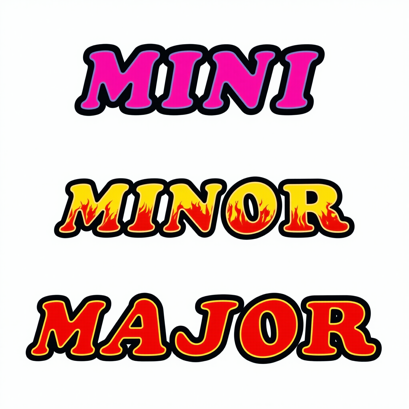

In [32]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, anime-style font, each word placed separately with clear empty space around it. The words are not touching or overlapping, ensuring they stand alone with well-balanced white space between them. The typography embodies the energetic, dynamic, and eye-catching aesthetic of Japanese anime title designs, inspired by shonen action series, mecha anime, and high-energy opening sequences. The font is bold, exaggerated, and slightly angled, with sharp edges, thick strokes, and a fast-paced, electric feel.
The colors remain vibrant and high-contrast, featuring neon pinks, electric blues, fiery reds, and golden yellows, capturing the intensity and excitement of anime visuals. Each word is outlined individually, without overlapping strokes or elements from other words. No motion lines or speed effects connecting the words—each is completely isolated, floating independently in the design.
The background remains fully white, ensuring that the typography pops with an intense, anime-inspired visual impact while maintaining clean separation between words. No additional symbols or elements—just pure anime-style typography, where each word stands alone in a well-spaced, high-energy composition.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

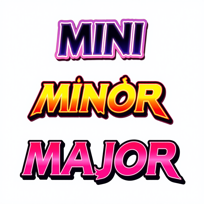

In [33]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, anime-style font, each word placed separately with clear empty space around it. The words are not touching or overlapping, ensuring they stand alone with well-balanced white space between them. The typography embodies the energetic, dynamic, and eye-catching aesthetic of Japanese anime title designs, inspired by shonen action series, mecha anime, and high-energy opening sequences. The font is bold, exaggerated, and slightly angled, with sharp edges, thick strokes, and a fast-paced, electric feel.
The colors remain vibrant and high-contrast, featuring neon pinks, electric blues, fiery reds, and golden yellows, capturing the intensity and excitement of anime visuals. Each word is outlined individually, without overlapping strokes or elements from other words. No motion lines or speed effects connecting the words—each is completely isolated, floating independently in the design.
The background remains fully white, ensuring that the typography pops with an intense, anime-inspired visual impact while maintaining clean separation between words. No additional symbols or elements—just pure anime-style typography, where each word stands alone in a well-spaced, high-energy composition.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [34]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, anime-style font, each word placed separately with clear empty space around it. The words are not touching or overlapping, ensuring they stand alone with well-balanced white space between them. The typography embodies the energetic, dynamic, and eye-catching aesthetic of Japanese anime title designs, inspired by shonen action series, mecha anime, and high-energy opening sequences. The font is bold, exaggerated, and slightly angled, with sharp edges, thick strokes, and a fast-paced, electric feel.
The colors remain vibrant and high-contrast, featuring neon pinks, electric blues, fiery reds, and golden yellows, capturing the intensity and excitement of anime visuals. Each word is outlined individually, without overlapping strokes or elements from other words. No motion lines or speed effects connecting the words—each is completely isolated, floating independently in the design.
The background remains fully white, ensuring that the typography pops with an intense, anime-inspired visual impact while maintaining clean separation between words. No additional symbols or elements—just pure anime-style typography, where each word stands alone in a well-spaced, high-energy composition.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1500, 1500)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

ValueError: Bad response from FLUX API. Status code: 500

In [ ]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, anime-style font, each word completely isolated with ample white space around it. The words are not touching, not overlapping, and are positioned separately from each other with a large, clean gap of white space between them. Each word appears individually centered in its own space, ensuring complete separation.
The typography embodies the energetic, dynamic, and eye-catching aesthetic of Japanese anime title designs, inspired by shonen action series, mecha anime, and high-energy opening sequences. The font is bold, exaggerated, and slightly angled, with sharp edges, thick strokes, and a fast-paced, electric feel.
The colors are vibrant and high-contrast, featuring neon pinks, electric blues, fiery reds, and golden yellows, capturing the intensity and excitement of anime visuals. Each word has its own thick, colorful outline and effects, but no motion lines or speed effects connecting them—each is fully separated in its own isolated space.
The background is entirely white and extends around every word, making sure there are no overlapping elements, no surrounding decorations, and no visual connections between the words. This ensures that each word is floating freely, fully visible, and perfectly readable in its own clean space.
No additional symbols or elements—just pure anime-style typography with individual, well-separated words and an ultra-clean layout.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1500, 1500)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [35]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, anime-style font, each word placed separately with clear empty space around it. The words are not touching or overlapping, ensuring they stand alone with well-balanced white space between them. The typography embodies the energetic, dynamic, and eye-catching aesthetic of Japanese anime title designs, inspired by shonen action series, mecha anime, and high-energy opening sequences. The font is bold, exaggerated, and slightly angled, with sharp edges, thick strokes, and a fast-paced, electric feel.
The colors remain vibrant and high-contrast, featuring neon pinks, electric blues, fiery reds, and golden yellows, capturing the intensity and excitement of anime visuals. Each word is outlined individually, without overlapping strokes or elements from other words. No motion lines or speed effects connecting the words—each is completely isolated, floating independently in the design.
The background remains fully white, ensuring that the typography pops with an intense, anime-inspired visual impact while maintaining clean separation between words. No additional symbols or elements—just pure anime-style typography, where each word stands alone in a well-spaced, high-energy composition.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))
print(single_image_path)

data_prize_words/generated/PRICE_930c0.png


In [36]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, Star Wars-style font, each word placed separately with clear empty space around it. The words are not touching or overlapping, ensuring they stand alone with well-balanced white space between them.
The typography embodies the futuristic, cinematic, and iconic aesthetic of the Star Wars universe, inspired by the legendary title designs, classic sci-fi lettering, and the opening crawl of the movies. The font is bold, angular, and slightly slanted, with sharp edges and a futuristic, space-inspired feel, resembling the epic, galactic adventure theme of Star Wars logos and posters.
The colors remain deep and cosmic, featuring glowing golden yellows, rich metallic silvers, and deep-space blacks, capturing the legendary and futuristic essence of Star Wars typography. Each word is outlined individually with a thick, cinematic stroke, creating a strong sci-fi impact. No motion blur or speed effects—each word appears fully separated, floating independently as if in deep space.
The background remains fully white, ensuring that the typography pops with a high-contrast, intergalactic feel while maintaining clean separation between words. No additional symbols or elements—just pure Star Wars-style typography, where each word stands alone in a well-spaced, epic sci-fi composition.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
display(Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2))))
print(single_image_path)

data_prize_words/generated/PRICE_471c2.png


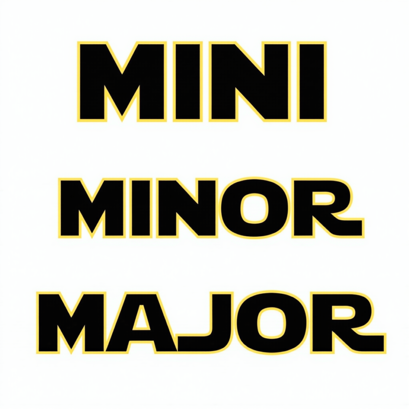

In [39]:
display(Image.open('data_prize_words/generated/PRICE_471c2.png').resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2))))

In [37]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, festive New Year-style font, each word placed separately with clear empty space around it. The words are not touching or overlapping, ensuring they stand alone with well-balanced white space between them.
The typography embodies the joyful, celebratory, and glamorous aesthetic of New Year’s Eve, inspired by glittering party decorations, festive countdowns, and elegant holiday invitations. The font is bold and stylish, with sleek curves, dynamic strokes, and an elegant, slightly decorative feel, evoking the excitement and grandeur of a New Year’s celebration.
The colors are luxurious and festive, featuring golden sparkles, shimmering silvers, deep midnight blues, and radiant champagne hues, capturing the excitement of fireworks, confetti, and glamorous celebrations. Each word is outlined individually with a glowing or metallic effect, adding a sophisticated, high-energy party atmosphere. No motion blur or overlapping strokes—each word appears fully separated, floating independently like words on a festive countdown screen.
The background remains fully white, ensuring that the typography pops with a dazzling, celebratory impact while maintaining clean separation between words. No additional symbols or elements—just pure New Year-style typography, where each word stands alone in a well-spaced, festive composition, radiating joy, anticipation, and celebration.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
display(Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2))))
print(single_image_path)

data_prize_words/generated/PRICE_4943f.png


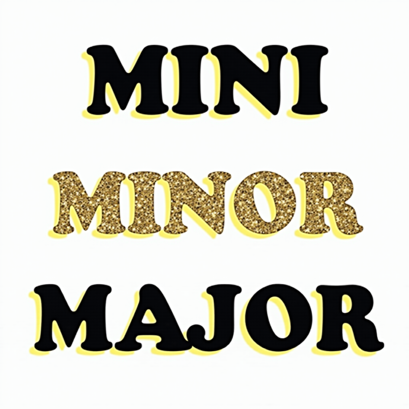

In [38]:
display(Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2))))

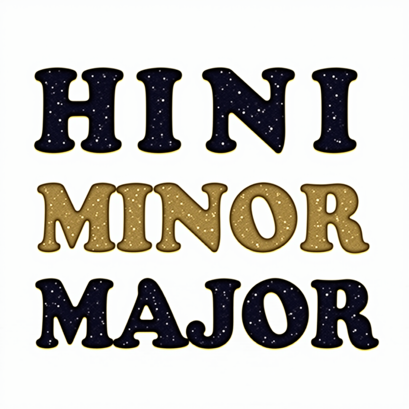

data_prize_words/generated/PRICE_8714f.png


In [40]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, festive New Year-style font, each word placed separately with clear empty space around it. The words are not touching or overlapping, ensuring they stand alone with well-balanced white space between them.

The typography embodies the joyful, celebratory, and glamorous aesthetic of New Year’s Eve, inspired by glowing city lights, grand countdowns, and festive toasts at midnight. The font is elegant yet bold, with smooth curves, refined strokes, and a decorative touch that evokes the magic and excitement of ringing in the New Year.

The colors are luxurious and radiant, featuring shimmering gold, brilliant silver, deep midnight blue, and sparkling champagne tones, capturing the glow of fireworks, confetti, and festive lights. Each word is outlined individually with a luminous or metallic sheen, adding a sophisticated, high-energy party atmosphere. Soft glowing highlights, subtle glitter textures, or tiny confetti-like sparkles may enhance the festive effect.

The background remains fully white, ensuring that the typography pops with a dazzling, celebratory impact while maintaining clean separation between words. No additional symbols or elements—just pure New Year-style typography, where each word stands alone in a well-spaced, elegant composition, exuding excitement, glamour, and the spirit of celebration.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
display(Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2))))
print(single_image_path)

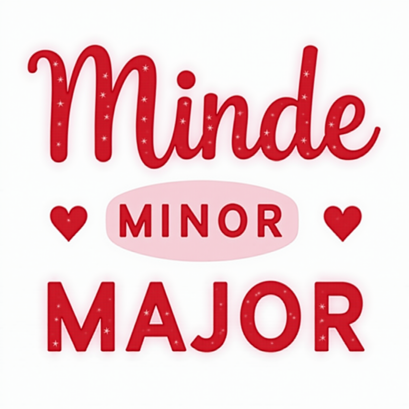

data_prize_words/generated/PRICE_17f37.png


In [41]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, romantic Valentine’s Day-style font, each word placed separately with clear empty space around it. The words are not touching or overlapping, ensuring they stand alone with well-balanced white space between them.

The typography embodies the sweet, affectionate, and love-filled aesthetic of Valentine’s Day, inspired by romantic handwritten letters, candy heart messages, and elegant wedding invitations. The font is stylish and decorative, with soft curves, smooth strokes, and a whimsical touch that evokes warmth, love, and tenderness. Some letters may have playful heart-shaped flourishes, gentle swirls, or delicate ribbon-like extensions to enhance the romantic charm.

The colors are soft, dreamy, and full of love, featuring passionate reds, blush pinks, delicate rose golds, and warm pastel hues, capturing the essence of roses, chocolates, and candlelit romance. Each word is outlined individually with a soft glow, shimmering highlights, or a delicate gradient, adding a heartfelt, affectionate atmosphere. Subtle sparkles, faint floral textures, or tiny heart-shaped accents may enhance the elegant Valentine’s aesthetic.

The background remains fully white, ensuring that the typography pops with a soft, romantic glow while maintaining clean separation between words. No additional symbols or elements—just pure Valentine’s Day-style typography, where each word stands alone in a well-spaced, love-filled composition, exuding charm, warmth, and romance.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (2048, 2048)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
display(Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2))))
print(single_image_path)

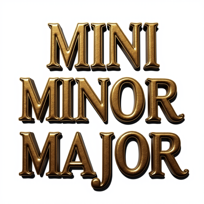

In [30]:
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the words ‘MINI’, ‘MINOR’, and ‘MAJOR’ in a bold, Egyptian Pharaoh-style font. The words are stacked vertically in the center, ensuring a balanced layout with equal spacing between each word. The typography embodies the regal, ancient, and mystical aesthetic of Egyptian hieroglyphs and pharaonic inscriptions, inspired by stone carvings, sacred temple writings, and legendary artifacts of the Nile civilization. The font is majestic and angular, with sharp serifs, elongated strokes, and intricate carvings, resembling the timeless elegance of hieroglyphic engravings and sacred scrolls.

The colors reflect a royal Egyptian palette, featuring rich gold, deep lapis blue, and sandstone beige, evoking the grandeur of pharaohs, ancient pyramids, and the golden treasures of the gods. Optional elements such as subtle ankh symbols, scarab motifs, or faint pyramid silhouettes may be incorporated into the letters, enhancing the authentic ancient Egyptian feel. A textured, weathered look or engraved stone effect may give the words the appearance of being chiseled into an ancient temple wall or golden artifact.

The background remains fully white, ensuring the typography pops with its divine and mystical presence. No additional symbols or elements—just pure Egyptian Pharaoh-style typography, bringing a mix of ancient mystery, royal elegance, and timeless power.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

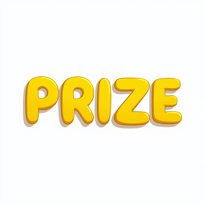

In [22]:
word = 'PRIZE'
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the word ‘{word}’ in a bold, SpongeBob-style font, perfectly centered in the composition. The letters have a wobbly, bubbly, and playful underwater look, inspired by the classic SpongeBob SquarePants logo. The font is cartoonish and fun, with slightly irregular, bouncy shapes that feel like they’re floating underwater. The text is outlined with a thick, bold stroke, enhancing its cheerful and goofy energy.

The colors are bright and tropical, featuring sunny yellows, ocean blues, and coral oranges, evoking the vibrant Bikini Bottom atmosphere. Subtle drop shadows and bubbly textures add an aquatic, lighthearted feel, making the word look squishy, spongy, or slightly wavy, as if submerged in water. The background remains fully white, ensuring the typography pops vividly with a clean, central focus. No extra symbols or elements—just pure SpongeBob-style, fun cartoon typography with a single centered word.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

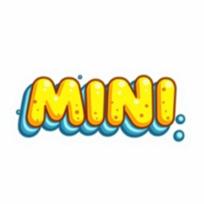

In [23]:
word = 'MINI'
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the word ‘{word}’ in a bold, SpongeBob-style font, perfectly centered in the composition. The letters have a wobbly, bubbly, and playful underwater look, inspired by the classic SpongeBob SquarePants logo. The font is cartoonish and fun, with slightly irregular, bouncy shapes that feel like they’re floating underwater. The text is outlined with a thick, bold stroke, enhancing its cheerful and goofy energy.

The colors are bright and tropical, featuring sunny yellows, ocean blues, and coral oranges, evoking the vibrant Bikini Bottom atmosphere. Subtle drop shadows and bubbly textures add an aquatic, lighthearted feel, making the word look squishy, spongy, or slightly wavy, as if submerged in water. The background remains fully white, ensuring the typography pops vividly with a clean, central focus. No extra symbols or elements—just pure SpongeBob-style, fun cartoon typography with a single centered word.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

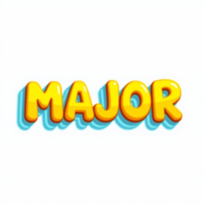

In [24]:
word = 'MAJOR'
words_prompt_mini_minor = f"""
A high-resolution typography design featuring the word ‘{word}’ in a bold, SpongeBob-style font, perfectly centered in the composition. The letters have a wobbly, bubbly, and playful underwater look, inspired by the classic SpongeBob SquarePants logo. The font is cartoonish and fun, with slightly irregular, bouncy shapes that feel like they’re floating underwater. The text is outlined with a thick, bold stroke, enhancing its cheerful and goofy energy.

The colors are bright and tropical, featuring sunny yellows, ocean blues, and coral oranges, evoking the vibrant Bikini Bottom atmosphere. Subtle drop shadows and bubbly textures add an aquatic, lighthearted feel, making the word look squishy, spongy, or slightly wavy, as if submerged in water. The background remains fully white, ensuring the typography pops vividly with a clean, central focus. No extra symbols or elements—just pure SpongeBob-style, fun cartoon typography with a single centered word.
"""

gen_params = {
    'num_inference_steps': 30, 
    'guidance_scale': 10.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_mini_minor, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))

In [21]:
single_image_path

PosixPath('data_prize_words/generated/PRICE_3e285.png')

# Object detection with segmentation

In [15]:
import easyocr
import cv2
import matplotlib.pyplot as plt

In [119]:
def detect_multi_words(image_path: str, new_width=500, new_height=500):
    image = cv2.imread(image_path)
    image = cv2.resize(image, (new_width, new_height), interpolation=cv2.INTER_LINEAR)
    # Convert to grayscale (optional, for better readability)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Initialize EasyOCR reader
    reader = easyocr.Reader(['en'])
    
    # Perform OCR on the image
    results = reader.readtext(gray)
    
    
    # Process detected text and split multi-word results
    processed_results = []
    for bbox, text, prob in results:
        words = text.split()  # Split words if multiple are detected
        if len(words) > 1:
            # Estimate new bounding boxes by splitting the original one
            x_min = min([point[0] for point in bbox])
            x_max = max([point[0] for point in bbox])
            y_min = min([point[1] for point in bbox])
            y_max = max([point[1] for point in bbox])
            
            width_per_word = (x_max - x_min) // len(words)  # Divide box equally
            
            for i, word in enumerate(words):
                new_bbox = [[x_min + i * width_per_word, y_min], 
                            [x_min + (i + 1) * width_per_word, y_min],
                            [x_min + (i + 1) * width_per_word, y_max], 
                            [x_min + i * width_per_word, y_max]]
                processed_results.append((new_bbox, word, prob / len(words)))
        else:
            processed_results.append((bbox, text, prob))


    print(processed_results)
    
    # Draw bounding boxes around detected and separated words
    for bbox, text, prob in processed_results:
        top_left = tuple(map(int, bbox[0]))
        bottom_right = tuple(map(int, bbox[2]))
        print('top left:', top_left)
        print('bottom right:', bottom_right)
        cv2.rectangle(image, top_left, bottom_right, (0, 255, 0), 2)
        cv2.putText(image, text, top_left, cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), 2)
    
    # Show the processed image with split words
    plt.figure(figsize=(10, 6))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()

In [152]:
import cv2
import torch
from PIL import Image
from rembg import new_session, remove
from torchvision import transforms
from transformers import AutoModelForImageSegmentation


def remove_background_from_symbol(src: str, dest: str) -> None:
    torch.set_float32_matmul_precision('high')

    device: str = 'cuda' if torch.cuda.is_available() else 'cpu'
    model: torch.nn.Module = AutoModelForImageSegmentation.from_pretrained(
        'briaai/RMBG-2.0', trust_remote_code=True
    )

    model.to(device)
    model.eval()

    to_pillow: transforms.ToPILImage = transforms.ToPILImage()

    transform_image: transforms.Compose = transforms.Compose(
        [
            transforms.Resize((1024, 1024)),
            transforms.ToTensor(),
        ]
    )

    img = Image.open(src)
    input_img: torch.Tensor = transform_image(img).unsqueeze(0).to(device)

    with torch.no_grad():
        mask: torch.Tensor = model(input_img)[-1].sigmoid()[0].squeeze().cpu()

    img.putalpha(to_pillow(mask).resize(img.size))
    img.save(dest)


def remove_background_from_frame(src: str, dest: str) -> None:
    torch.set_float32_matmul_precision('high')

    device: str = 'cuda' if torch.cuda.is_available() else 'cpu'

    model: torch.nn.Module = AutoModelForImageSegmentation.from_pretrained(
        'briaai/RMBG-2.0', trust_remote_code=True
    )



    model.to(device)
    model.eval()


    model_name: str = 'birefnet-general'

    session: BaseSession = new_session(model_name)

    cv2.imwrite(dest, remove(cv2.imread(src), session=session))

In [132]:
def detect_multi_words(image_path: str, new_width=500, new_height=500):
    image = cv2.imread(image_path)
    image = cv2.resize(image, (new_width, new_height), interpolation=cv2.INTER_LINEAR)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    reader = easyocr.Reader(['en'])
    results = reader.readtext(gray)

    processed_results = []
    for bbox, text, prob in results:
        words = text.split()
        if len(words) > 1:
            x_min = min([point[0] for point in bbox])
            x_max = max([point[0] for point in bbox])
            y_min = min([point[1] for point in bbox])
            y_max = max([point[1] for point in bbox])
            
            width_per_word = (x_max - x_min) // len(words)
            
            for i, word in enumerate(words):
                new_bbox = [[x_min + i * width_per_word, y_min], 
                            [x_min + (i + 1) * width_per_word, y_min],
                            [x_min + (i + 1) * width_per_word, y_max], 
                            [x_min + i * width_per_word, y_max]]
                processed_results.append((word, new_bbox, prob / len(words)))
        else:
            processed_results.append((text, bbox, prob))
    
    return processed_results, image

In [157]:
import os
import cv2
import matplotlib.pyplot as plt

def save_cropped_words(image, detected_words, output_folder="cropped_words"):

    # Create output folder if it doesn’t exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    cropped_images = []

    # Iterate through detected words and crop them
    for i, (word, bbox, prob) in enumerate(detected_words):
        # Ensure correct bounding box extraction
        x_min = int(min(point[0] for point in bbox))
        x_max = int(max(point[0] for point in bbox))
        y_min = int(min(point[1] for point in bbox))
        y_max = int(max(point[1] for point in bbox))

        # Ensure coordinates are within the image bounds
        x_min = max(0, x_min)
        y_min = max(0, y_min)
        x_max = min(image.shape[1], x_max)
        y_max = min(image.shape[0], y_max)

        # Prevent invalid cropping
        if x_max > x_min and y_max > y_min:
            cropped = image[y_min:y_max, x_min:x_max]
            print(x_min, x_max, y_min, y_max)
            filename = f"{output_folder}/{word}_{i}.png"
            cv2.imwrite(filename, cropped)

            # Store cropped image for visualization
            cropped_images.append((word, cropped, filename))
            
            remove_background_from_symbol(filename, filename)

    # Display cropped images
    fig, axes = plt.subplots(1, len(cropped_images), figsize=(10, 5))
    if len(cropped_images) == 1:
        axes = [axes]  # Ensure axes is iterable for a single word

    for ax, (word, cropped, filename) in zip(axes, cropped_images):
        ax.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
        ax.set_title(word)
        ax.axis("off")

    plt.show()

    return [img[2] for img in cropped_images]

In [154]:
pth = '/root/flux/notebooks/cropped_words/MINI_0.png'

remove_background_from_frame(pth, pth)

get model
get model
get model
get model session
deleting


In [150]:
print('hi')

hi


94 414 42 162
get model
get model
get model
get model session
deleting
73 452 206 304
get model
get model
get model
get model session
deleting
48 476 348 444
get model
get model
get model
get model session
deleting


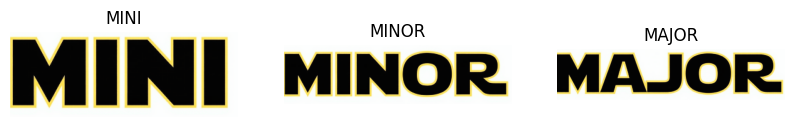

['cropped_words/MINI_0.png',
 'cropped_words/MINOR_1.png',
 'cropped_words/MAJOR_2.png']

In [156]:
image_path = "data_prize_words/generated/PRICE_471c2.png"

# Step 1: Detect words
detected_words, image = detect_multi_words(image_path)

# Step 2: Crop and show each detected word
save_cropped_words(image, detected_words)

In [123]:
detected_words

[('MINI', [[94, 42], [414, 42], [414, 162], [94, 162]], 0.7467544889236573),
 ('MINOR', [[73, 206], [452, 206], [452, 304], [73, 304]], 0.9996692991160661),
 ('MAJOR', [[48, 348], [476, 348], [476, 444], [48, 444]], 0.9995913535485024)]

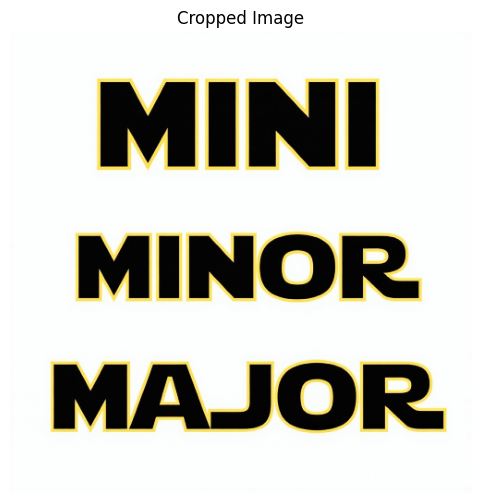

In [131]:
import cv2
import matplotlib.pyplot as plt

def crop_and_plot(image_path, x_min, x_max, y_min, y_max):
    # Load the image
    image = cv2.imread(image_path)
    new_width=500
    new_height=500
    image = cv2.imread(image_path)
    image = cv2.resize(image, (new_width, new_height), interpolation=cv2.INTER_LINEAR)
    

    # Ensure coordinates are within the image bounds
    x_min = max(0, x_min)
    y_min = max(0, y_min)
    x_max = min(image.shape[1], x_max)
    y_max = min(image.shape[0], y_max)

    # Crop the image
    cropped = image[y_min:y_max, x_min:x_max]

    # Plot the cropped image
    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Cropped Image")
    plt.show()

    # return cropped  # Return cropped image if needed

# Example Usage
image_path = "data_prize_words/generated/PRICE_471c2.png"
x_min, x_max = 0, 900
y_min, y_max = 0, 900

crop_and_plot(image_path, x_min, x_max, y_min, y_max)

[([[94, 42], [414, 42], [414, 162], [94, 162]], 'MINI', 0.7467544889236573), ([[73, 206], [452, 206], [452, 304], [73, 304]], 'MINOR', 0.9996692991160661), ([[48, 348], [476, 348], [476, 444], [48, 444]], 'MAJOR', 0.9995913535485024)]
top left: (94, 42)
bottom right: (414, 162)
top left: (73, 206)
bottom right: (452, 304)
top left: (48, 348)
bottom right: (476, 444)


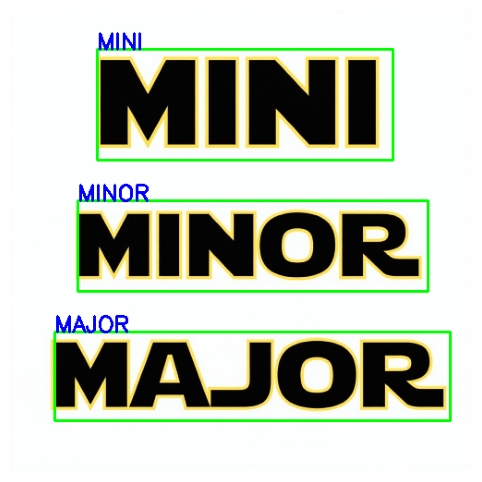

In [116]:
image_path = "data_prize_words/generated/PRICE_471c2.png"

detected_words = detect_multi_words(image_path)

In [18]:
print('hi')

hi


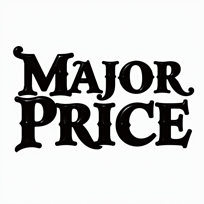

In [13]:
words_prompt_major_price = """
The stylized words **"MAJOR" and "PRICE"** **must both be clearly visible** in the image, arranged **one on top of the other in a perfect vertical alignment**, evenly spaced and aligned **without rotation**.

Each word is **large, bold, and uniform in size**, featuring a **fantasy-style medieval or fairy tale lettering**, similar to the **iconic Shrek title font**.

The background is completely **pure white**, ensuring the words remain **isolated and clearly visible**, with no distractions.

Each word is positioned **exactly as follows**:
- **“MAJOR”** on the **top**, appearing bold and heroic.
- **“PRICE”** on the **bottom**, looking strong and mystical.

The words should be **highly legible, crisp, and well-separated**, ensuring that no word is missing, cropped, or obscured.

**Important:** The image **must not contain any extra words**. Only **"MAJOR" and "PRICE"** should be present in the design. If any extra words appear, the image is incorrect and must be re-generated.
"""

gen_params = {
    'num_inference_steps': 50, 
    'guidance_scale': 5.0,
    'seed': 2,
    'resolution': (1024, 1024)
}

single_image_path = generate_single_image(prompt=words_prompt_major_price, word='PRICE', gen_params=gen_params)
Image.open(single_image_path).resize((int(gen_params['resolution'][0]/10*2),int(gen_params['resolution'][1]/10*2)))